In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn import cluster, datasets
from pandas import DataFrame as df
from IPython.display import clear_output

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import learning_curve

import keras
from keras.models import load_model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.layers.core import  Activation, Dropout  
from keras.optimizers import RMSprop
from keras.layers import Embedding, RepeatVector
from keras.layers import LSTM
from keras.layers.recurrent import GRU
from keras.optimizers import SGD
from sklearn.preprocessing import MinMaxScaler

import DailyMLPModel as D
import DailyNNModel as DNN
import DailyNeuralNetworkModel1 as DNNm
from DailyNeuralNetworkModel1 import getWinterForecastingResults
import datetime

%matplotlib inline
#%matplotlib qt
%config InlineBackend.figure_format = 'retina'

/Users/mac/anaconda/lib/python2.7/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using Theano backend.


In [15]:
def import_data():
    dataset = pd.read_csv('../data/DP.csv',usecols=[27],engine='python')
    return dataset
def mean_absolute_percentage_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())
def mean_absolute_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) )) 


def prepareInputs(daydata, season, UsedInputs,testPeriod):
    nbrInputs= 0
    
    previousHours = UsedInputs[0]
    timeSteps = int(UsedInputs[1])
    previousDay = UsedInputs[2]
    previousWeek = UsedInputs[3]
    temp = UsedInputs[4]
    tempMax = UsedInputs[5]
    tempMin = UsedInputs[6]
    dayIndicator = UsedInputs[7]
    HourIndicator= UsedInputs[8]
    monthIndicator = UsedInputs[9]
    
    if previousHours == True: 
        nbrInputs = nbrInputs + int(timeSteps)
    if previousDay == True: nbrInputs= nbrInputs+1
    if previousWeek == True : nbrInputs= nbrInputs+ 1
    if temp == True: nbrInputs= nbrInputs+1
    if tempMax == True: nbrInputs= nbrInputs+1
    if tempMin == True: nbrInputs= nbrInputs+1
    if dayIndicator== True: nbrInputs= nbrInputs+7
    if HourIndicator== True : nbrInputs= nbrInputs+24
    if monthIndicator== True : nbrInputs= nbrInputs + 12
    
    
    hourclusters= np.empty([(daydata.index.size*24),1])

    hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

    for x in range(0,daydata.index.size):
        for y in range(0,24):
            hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
    hourclusters.size

    tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
    tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
    tempnp= np.array(tempA)
    tempnp= tempnp.reshape(-1,1)
    tempdata= pd.DataFrame(tempnp)

    tempmax= tempAlgiers.loc[:,'Tmax']
    tempmin= tempAlgiers.loc[:,'Tmin']




    tempmx= np.random.random([tempmax.size*24,1])
    tempmn= np.random.random([tempmin.size*24,1])



    for x in range(0,tempmax.size):
        for y in range(0,24):
            tempmx[(x * 24) + y,0] = tempmax.iloc[x]

    for x in range(0,tempmin.size):
        for y in range(0,24):
            tempmn[(x * 24) + y,0] = tempmin.iloc[x]
        

    samples = daydata.index.size*24
    daydata2= daydata.copy()
    del(daydata2['cluster'])

    data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

    maxcons= data.values.max()
    mincons= data.values.min()

    maxtemp= np.max(tempdata.values)
    mintemp= tempdata.values.min()

    maxtempmax= np.max(tempmx)
    mintempmax= np.min(tempmx)

    maxtempmin= np.max(tempmn)
    mintempmin= np.min(tempmn)

    sigxx= np.empty((samples - 168 , nbrInputs))
    sigyy= np.empty((samples - 168 , 1))

    i= 0
    for x in list(range(168,samples)):
        i=0
        if previousHours == True: 
            for y in list(range(timeSteps)):
                sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
                i= i + 1
        if previousDay == True: 
            sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
            i= i+1
        if previousWeek == True : 
            sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
            i= i+ 1
        if temp == True: 
            sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
            i= i+1
        if tempMax == True: 
            sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
            i= i+1
        if tempMin == True: 
            sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
            i= i+1
        if dayIndicator == True:
            ind=0
            for y in range(0,7):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
            i = i + 7
        if HourIndicator == True:
            ind=0
            for y in range(0,24):
                sigxx[x - 168 , i+ind]= 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].hour]=1
            i = i + 24
        if monthIndicator == True:
            ind=0
            for y in range(0,12):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].month - 1]=1
            i = i + 12 
    
    for x in list(range(168,samples)):
        sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

    sigmoidxx= df(sigxx.copy())
    sigmoidyy= df(sigyy.copy())

    sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
    sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

    sigmoidxx['cluster'] = hourclusters[168:]
    sigmoidyy['cluster'] = hourclusters[168:]
    dfhourclusters = df(hourclusters)
    
    SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()
    
    SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
    del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
    learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    print('-------Input preparation process complet-------')
    return learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs



In [16]:
data = import_data()
data= np.array(data)
data= data.reshape(-1,24)

daydata= df(data)
daydata.index= pd.date_range('2014-1-1', periods=365, freq='D')

clusters= np.loadtxt('../data/Mixed_4_Clusters',delimiter=',')

pca= PCA(n_components=3)
pca.fit(daydata)
data_pca =  pca.transform(daydata)

# pdClusters= pd.DataFrame(clusters,index=daydata.index)
print(clusters)



# fig = plt.figure(1, figsize=(12, 9))

# ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=45, azim=135)

# dayofweek = pd.DatetimeIndex(daydata.index).dayofweek

# ax.scatter(data_pca[:,0],data_pca[:,1],data_pca[:,2],cmap=plt.cm.spectral,c=clusters,alpha= 0.4)

# plt.show()


daydata['cluster']=clusters

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0.
 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 4. 4. 4. 1.
 1. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3.
 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 4. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 4. 4. 2. 1. 1. 4. 1.
 1. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

In [18]:
testPeriod= 144

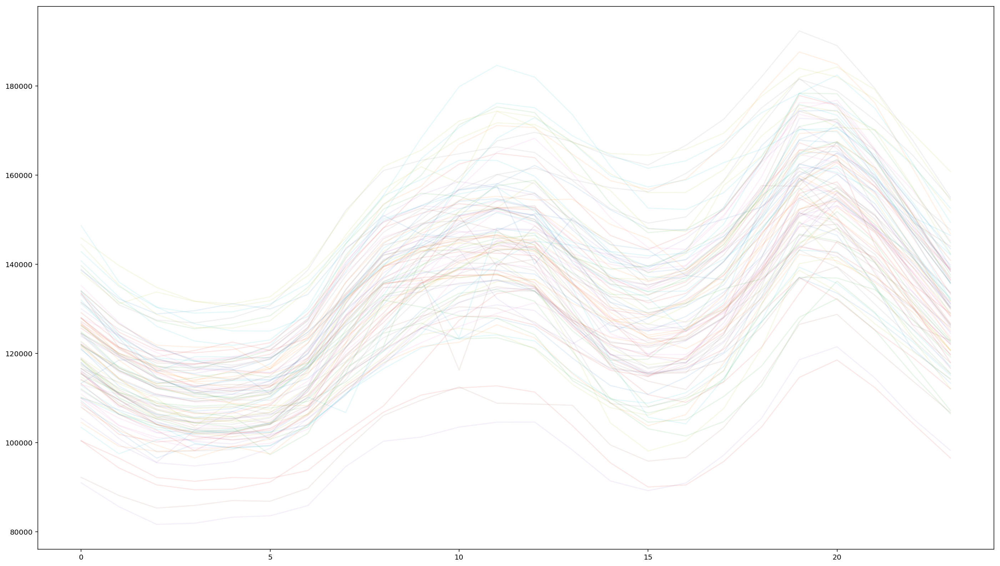

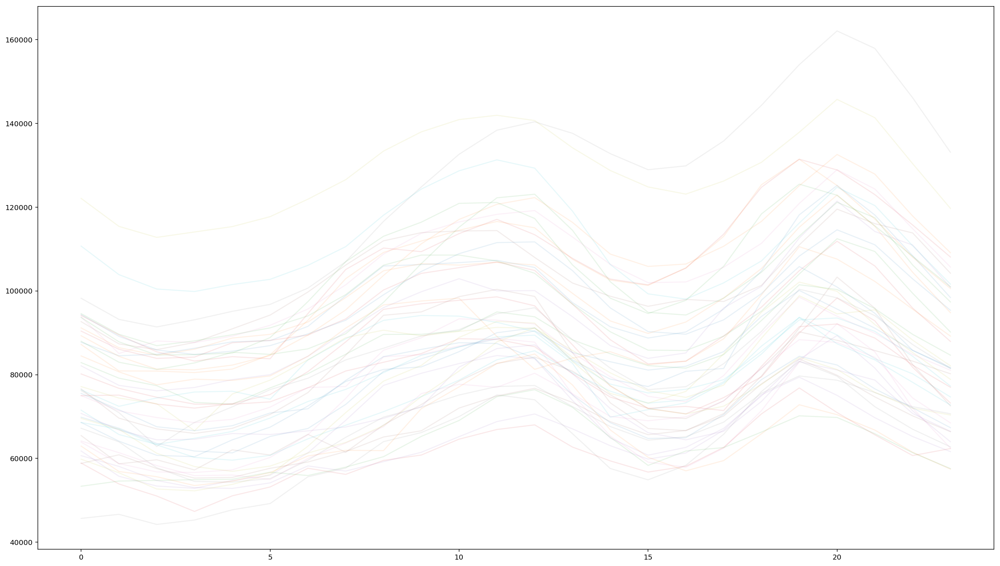

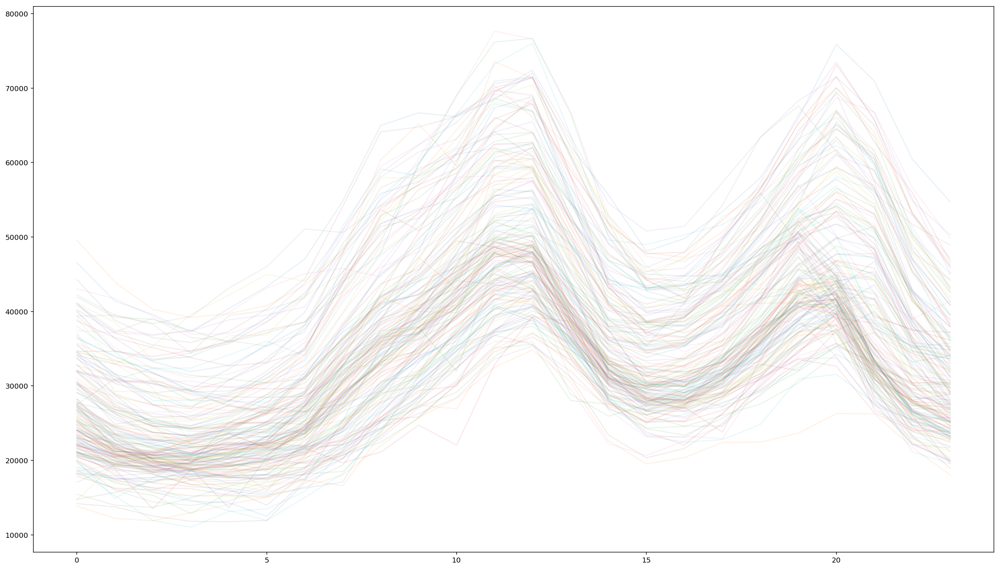

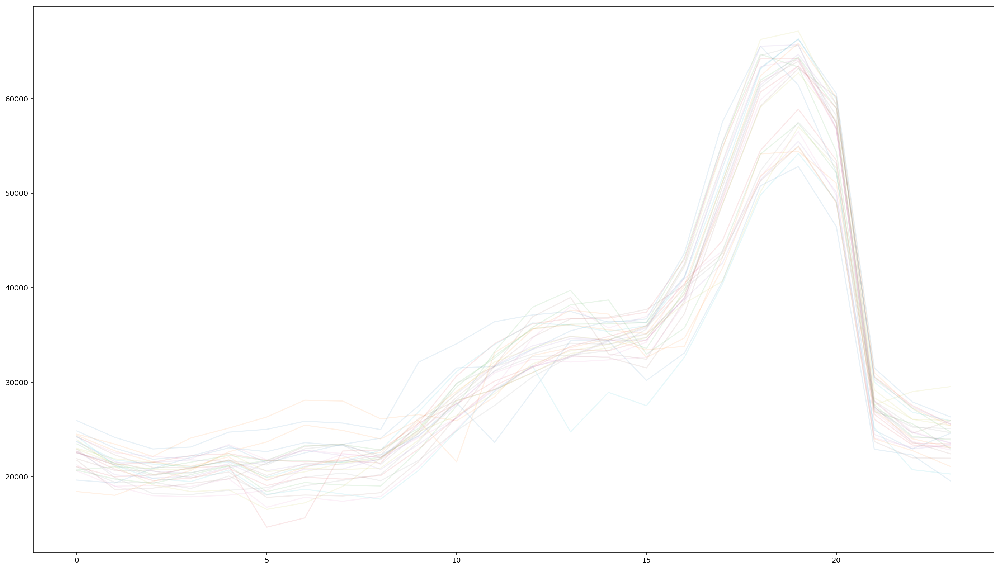

In [19]:

temp=daydata.copy()
del(temp['cluster'])

plt.figsize=(24,14)
temp[daydata.cluster==0].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==1].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==2].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==3].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)


plt.show()

In [20]:
def create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,n_features,HiddenNeurons1=None,HiddenNeurons2=None
                              ,LearningRate=None,Epoch=None,Optimizer=None, timeSteps= None):
    
    if HiddenNeurons1 is None: HiddenNeurons1 = 10
    if HiddenNeurons2 is None: HiddenNeurons2 = 5
    if LearningRate is None: LearningRate = 0.001
    if Epoch is None: Epoch = 500
    if Optimizer is None: Opitimizer = 'Adam'
    if timeSteps is None: timeSteps = 1
        
    mlpmodel = Sequential()
    # Dense(64) is a fully-connected layer with 64 hidden units.
    # in the first layer, you must specify the expected input data shape:
    # here, 20-dimensional vectors.
    mlpmodel.add(LSTM(units= HiddenNeurons1, return_sequences=True, activation='sigmoid', input_shape=(timeSteps, n_features)))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(LSTM(units= HiddenNeurons2, activation='sigmoid', return_sequences=False))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(Dense(1, init='uniform',activation='sigmoid'))
    mlpmodel.compile(optimizer=Optimizer, loss='mse')
#     mlpmodel.add(Dense(HiddenNeurons1, input_dim=inputx1.shape[1],activation='sigmoid'))
#     mlpmodel.add(Dense(HiddenNeurons2, init='uniform'))
#     mlpmodel.add(Dense(1, init='uniform'))
#     mlpmodel.add(Activation('sigmoid'))

#     sgd = SGD(lr=LearningRate, decay=1e-6, momentum=0.9, nesterov=True)
#     mlpmodel.compile(loss='mse', optimizer=Optimizer)

    tempMLPmodels= np.empty((Epoch),dtype=object)
    tempErrorHistory= np.empty((Epoch),dtype=object)

    counter=0

    for i in range(0,Epoch):
        print('epoch:   %d .' %counter)
        ErrorHistory= mlpmodel.fit(x=inputx1.reshape(-1,1,n_features), y=outputx1, epochs=1,batch_size=12
                                           ,validation_data=(inputx2.reshape(-1,1,n_features),outputx2),verbose= 2)
        tempMLPmodels[i]= mlpmodel
        mlpmodel.save('temp/lstm_%d_%s'%(i,season))
        tempErrorHistory[i]=ErrorHistory.history['val_loss']
        counter = counter +1    
    print('==============================================================================')
    print('\t \t LSTM model is ready for forecasting')
    print('==============================================================================')
    
    
    return tempMLPmodels, tempErrorHistory, mlpmodel

def getForecastingResults(tempMLPmodels, tempErrorHistory, learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

#     arg= tempErrorHistory.argmin()
#     Model = load_model('temp/lstm_%d_%s'%(arg,season))
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0]
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
       
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

In [21]:
season = 3
Epoch = 3000


UsedInputList = []
ModelsList = []
MAPErrorList = []
ForecastingList = []
Models_IDs = []
Models_parameters = []
Model_ID = 0
today = datetime.date.today()


	 	 test num : 0
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 3.31314635643 
Daily Learning mean absolute percentage error of 22 days : 4.8301449689 
	 	 MAPError plot through Learning DataSet 


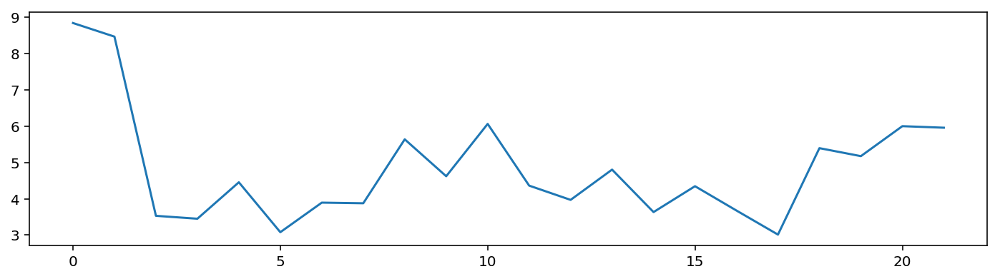

	 	 Test subset results
Test mean absolute percentage error per hour: 5.586237
Test mean absolute percentage error per day: 6.610317 
	 	 Validation Forecasting visualisation


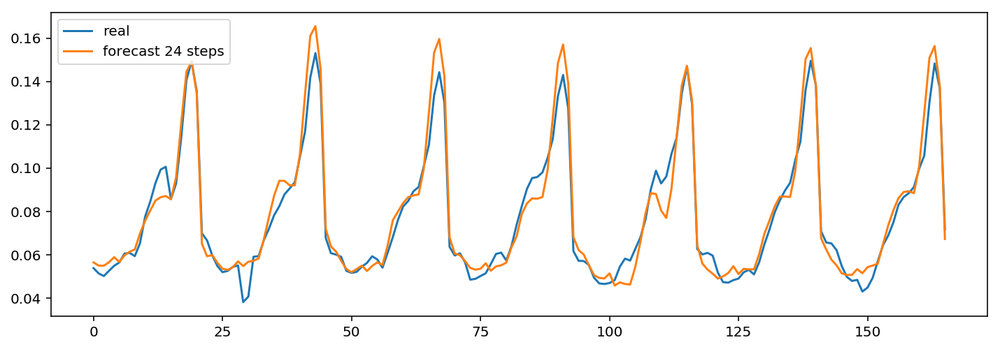

	 	 Forecasting a sample from Learning dataset


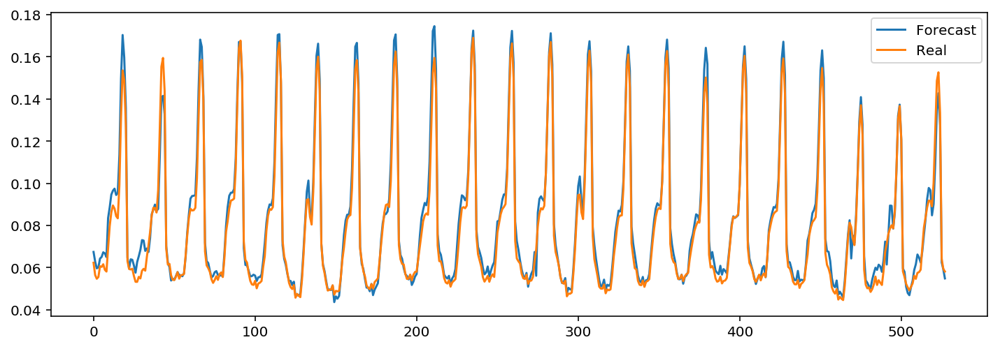

In [17]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 24
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 1
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.82758976904 
Daily Learning mean absolute percentage error of 22 days : 4.2710020217 
	 	 MAPError plot through Learning DataSet 


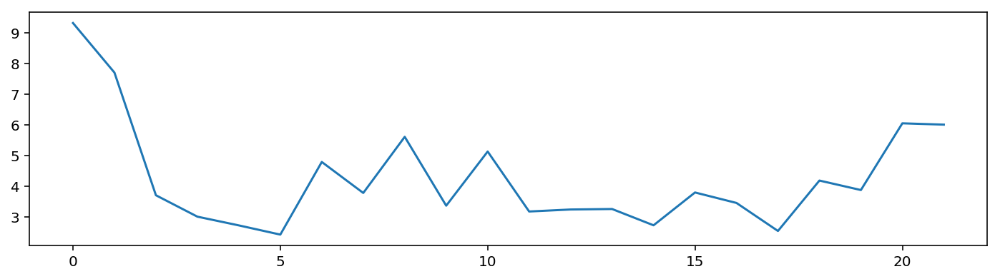

	 	 Test subset results
Test mean absolute percentage error per hour: 5.157833
Test mean absolute percentage error per day: 6.628031 
	 	 Validation Forecasting visualisation


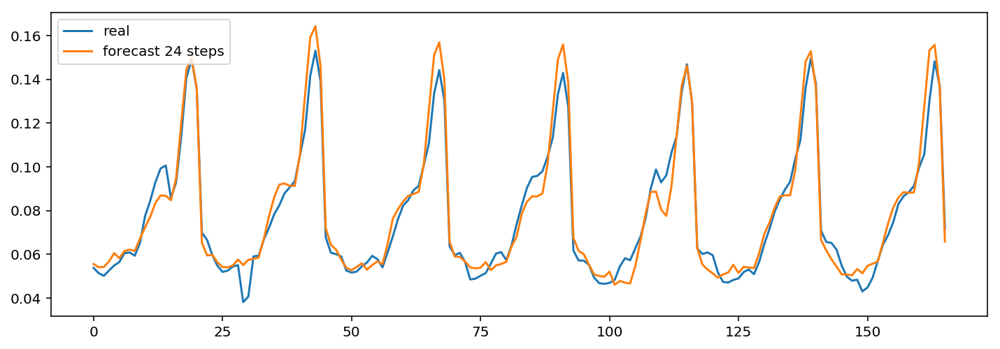

	 	 Forecasting a sample from Learning dataset


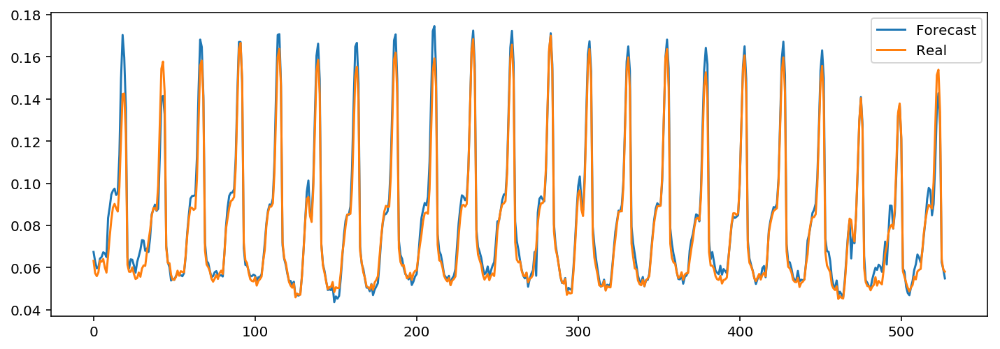

In [18]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 2
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.72451137411 
Daily Learning mean absolute percentage error of 22 days : 4.42952508276 
	 	 MAPError plot through Learning DataSet 


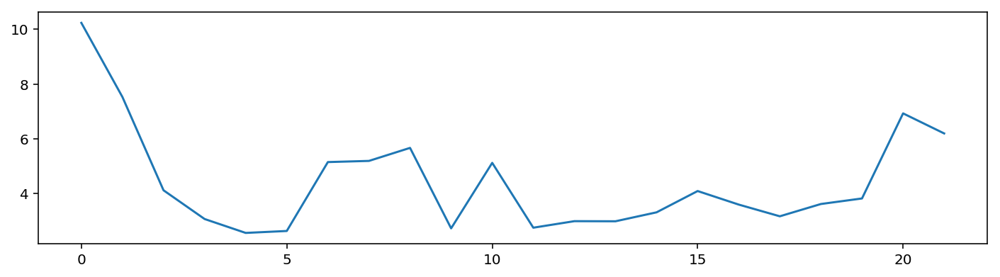

	 	 Test subset results
Test mean absolute percentage error per hour: 5.192749
Test mean absolute percentage error per day: 6.573019 
	 	 Validation Forecasting visualisation


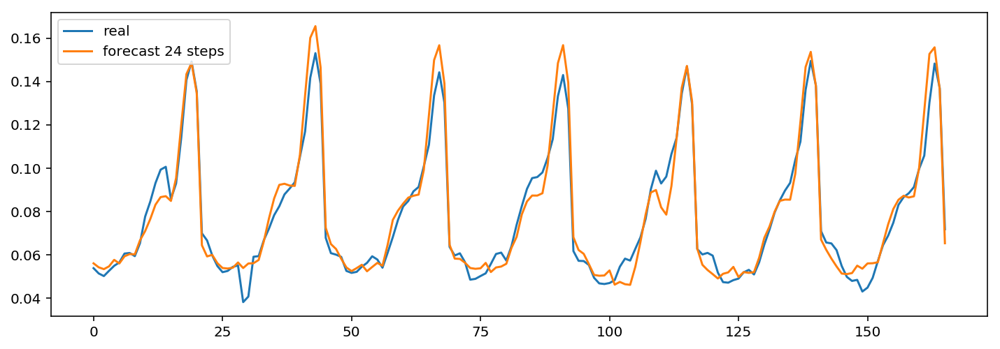

	 	 Forecasting a sample from Learning dataset


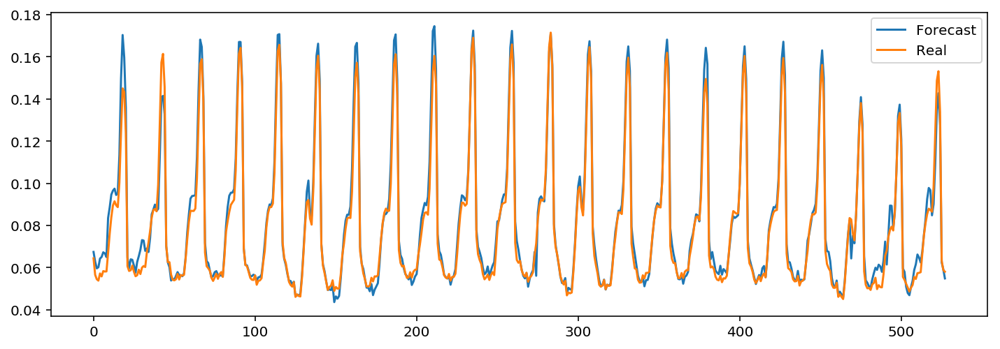

In [19]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 3
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.79521717304 
Daily Learning mean absolute percentage error of 22 days : 4.38579614054 
	 	 MAPError plot through Learning DataSet 


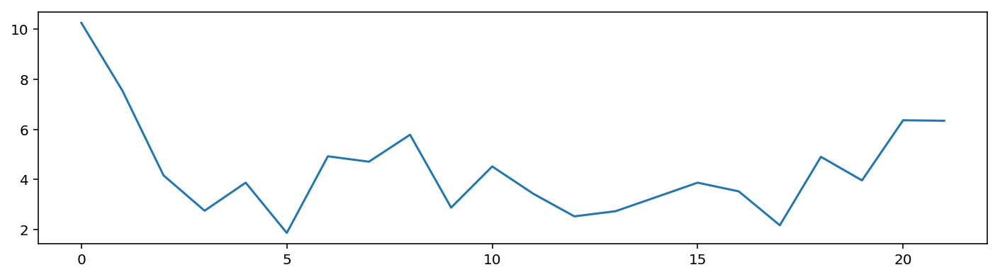

	 	 Test subset results
Test mean absolute percentage error per hour: 5.219000
Test mean absolute percentage error per day: 6.609058 
	 	 Validation Forecasting visualisation


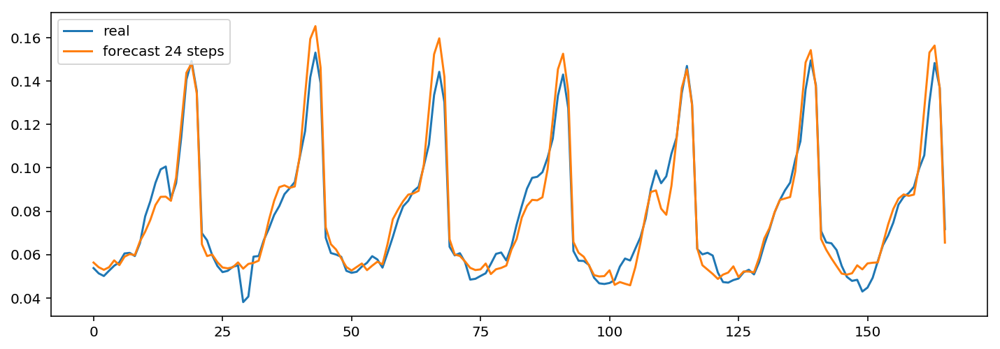

	 	 Forecasting a sample from Learning dataset


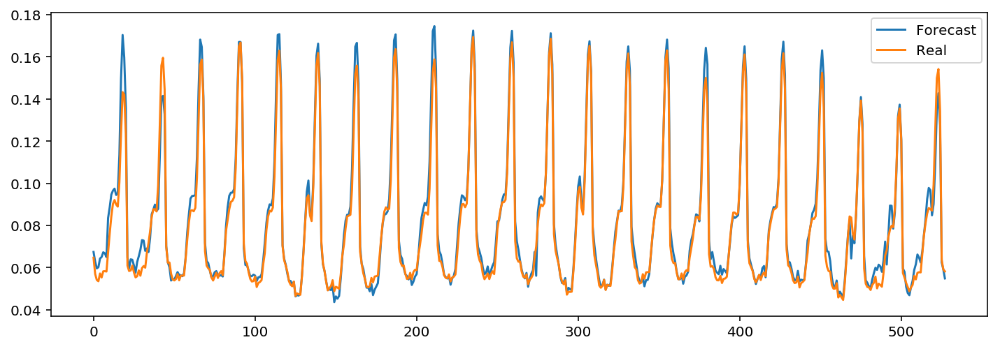

In [20]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 4
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.10665942221 
Daily Learning mean absolute percentage error of 22 days : 3.95691822334 
	 	 MAPError plot through Learning DataSet 


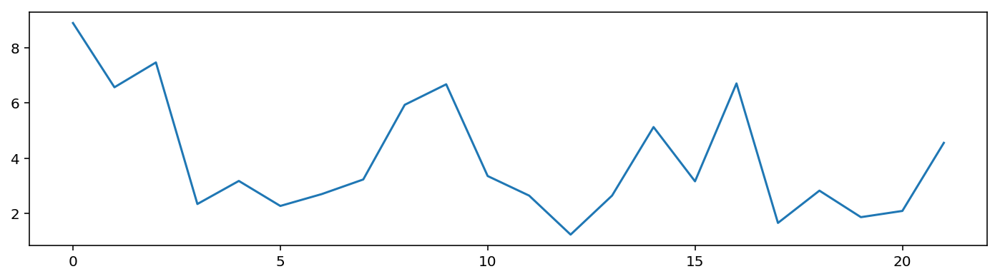

	 	 Test subset results
Test mean absolute percentage error per hour: 4.728046
Test mean absolute percentage error per day: 6.926382 
	 	 Validation Forecasting visualisation


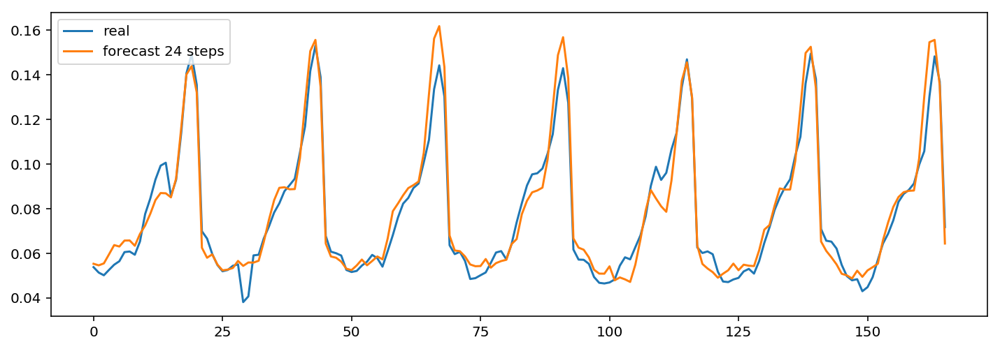

	 	 Forecasting a sample from Learning dataset


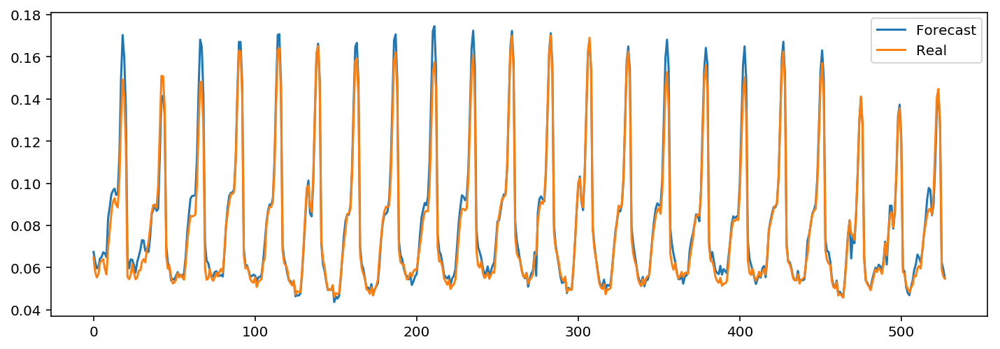

In [21]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 5
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.48437030142 
Daily Learning mean absolute percentage error of 22 days : 4.15961684422 
	 	 MAPError plot through Learning DataSet 


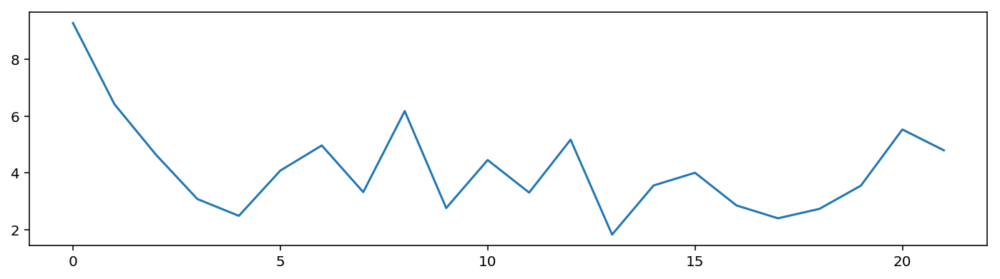

	 	 Test subset results
Test mean absolute percentage error per hour: 5.137476
Test mean absolute percentage error per day: 7.176886 
	 	 Validation Forecasting visualisation


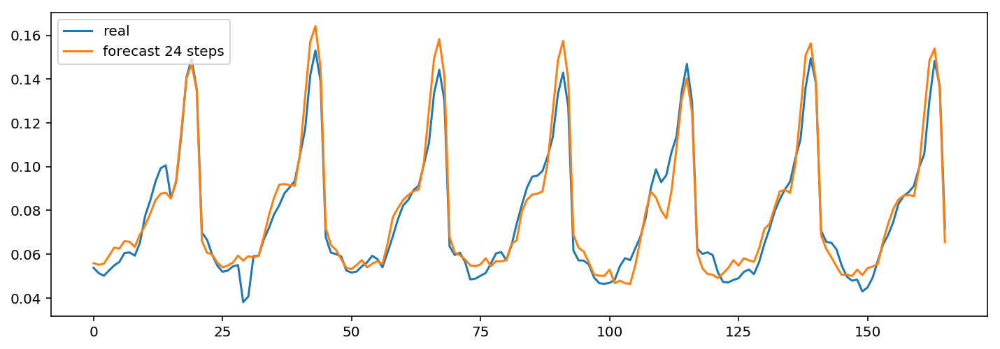

	 	 Forecasting a sample from Learning dataset


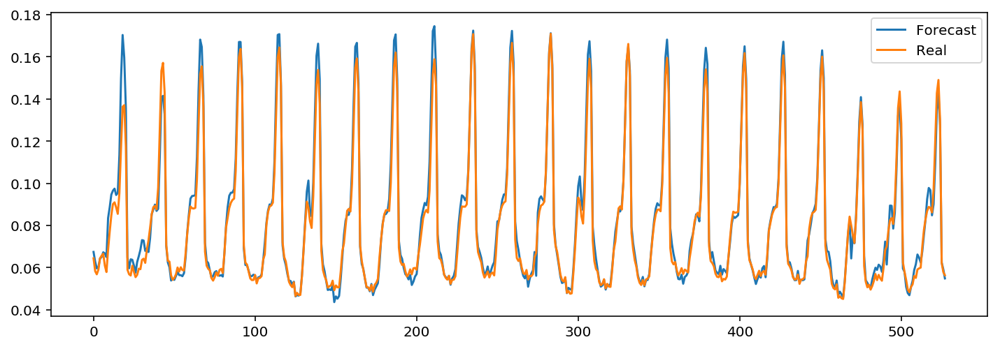

In [22]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')



LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 6
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.43785658659 
Daily Learning mean absolute percentage error of 22 days : 4.72754501213 
	 	 MAPError plot through Learning DataSet 


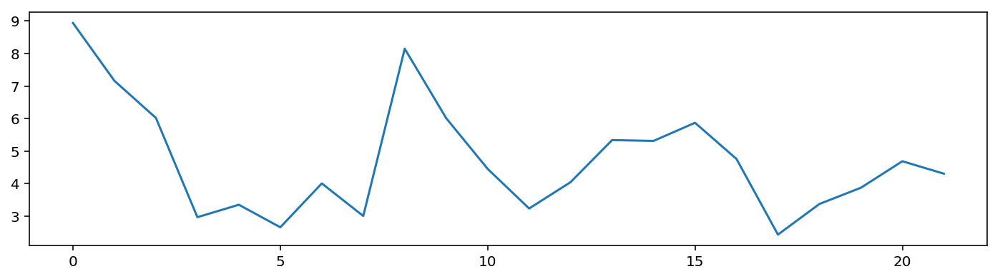

	 	 Test subset results
Test mean absolute percentage error per hour: 5.317092
Test mean absolute percentage error per day: 7.626915 
	 	 Validation Forecasting visualisation


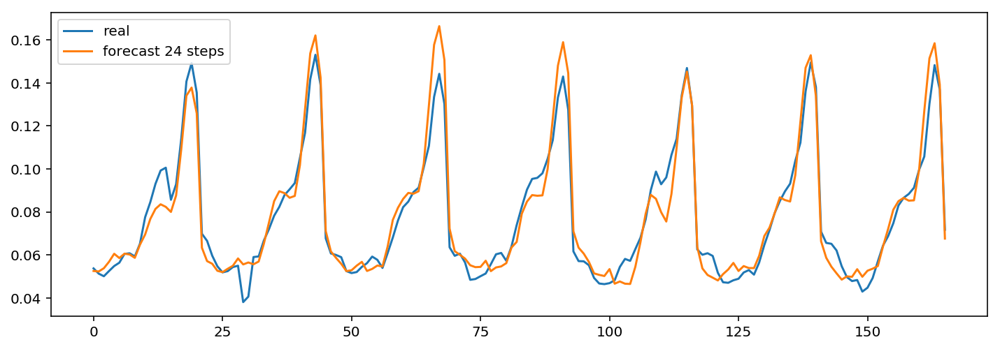

	 	 Forecasting a sample from Learning dataset


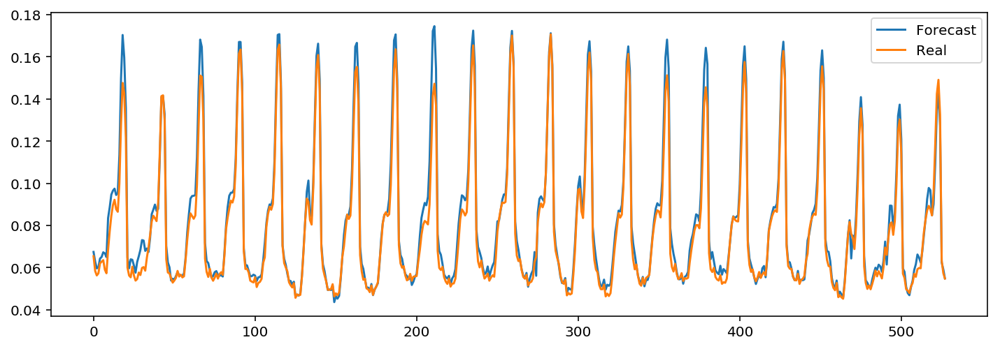

In [23]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 50
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 7
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.73763338073 
Daily Learning mean absolute percentage error of 22 days : 4.68855324658 
	 	 MAPError plot through Learning DataSet 


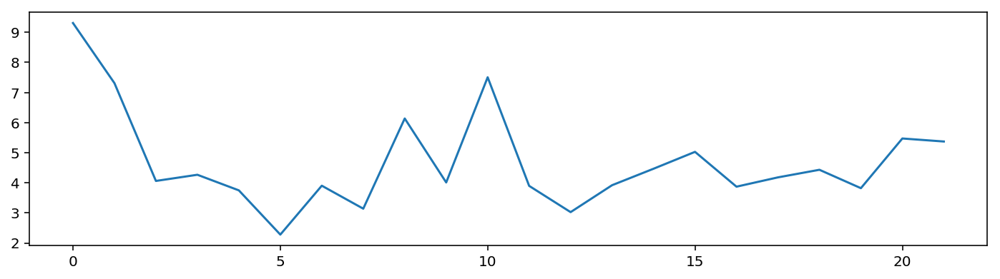

	 	 Test subset results
Test mean absolute percentage error per hour: 5.213115
Test mean absolute percentage error per day: 6.553393 
	 	 Validation Forecasting visualisation


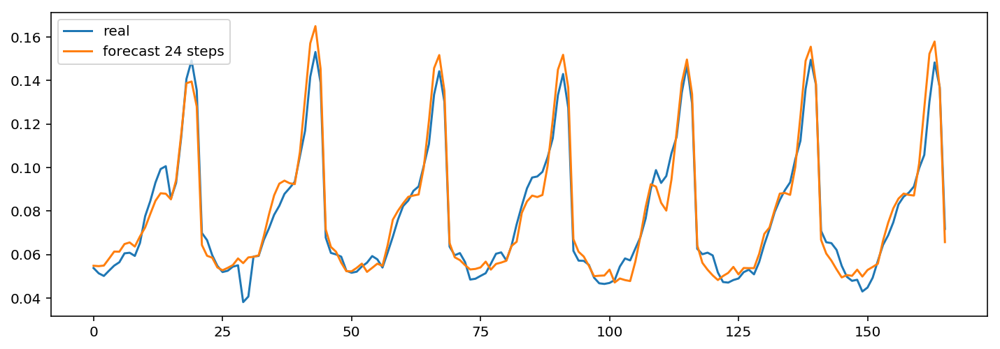

	 	 Forecasting a sample from Learning dataset


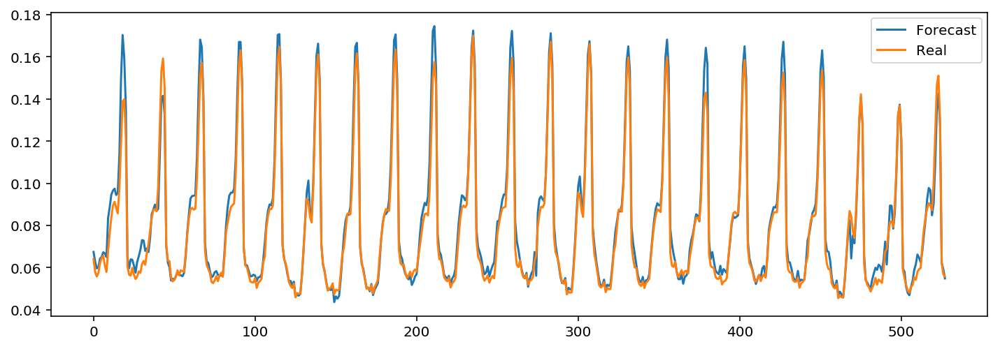

In [24]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 80
Parameters[1]= HiddenNeurons2 = 50
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 8
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.6635210561 
Daily Learning mean absolute percentage error of 22 days : 5.50259894674 
	 	 MAPError plot through Learning DataSet 


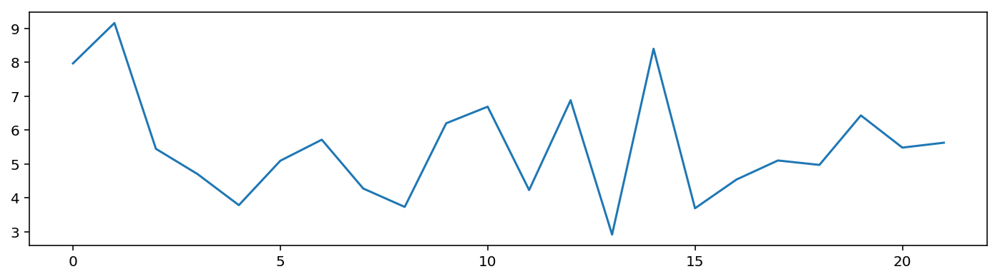

	 	 Test subset results
Test mean absolute percentage error per hour: 4.611500
Test mean absolute percentage error per day: 7.012889 
	 	 Validation Forecasting visualisation


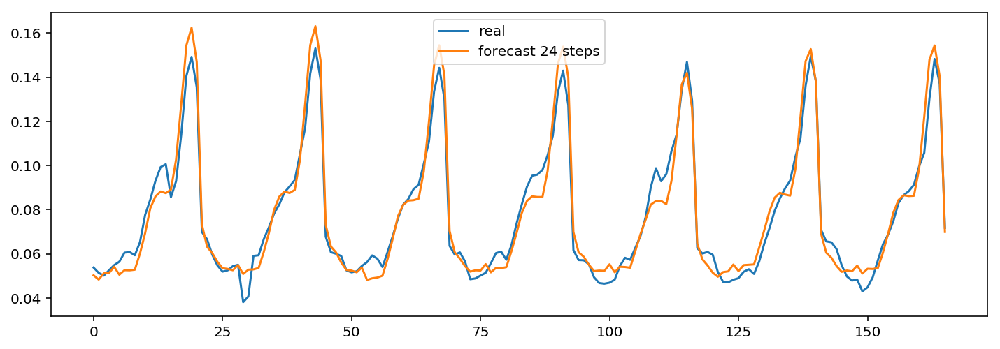

	 	 Forecasting a sample from Learning dataset


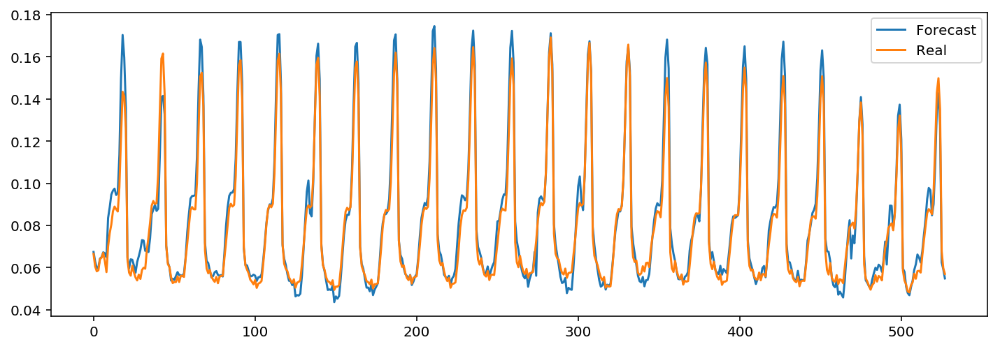

In [25]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 9
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.06843824321 
Daily Learning mean absolute percentage error of 22 days : 6.7280087471 
	 	 MAPError plot through Learning DataSet 


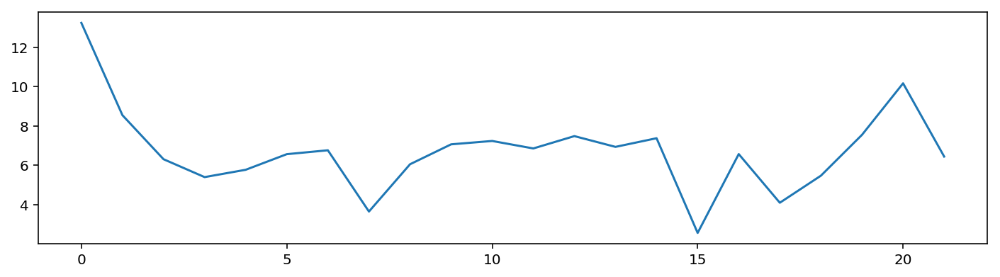

	 	 Test subset results
Test mean absolute percentage error per hour: 5.030946
Test mean absolute percentage error per day: 6.913289 
	 	 Validation Forecasting visualisation


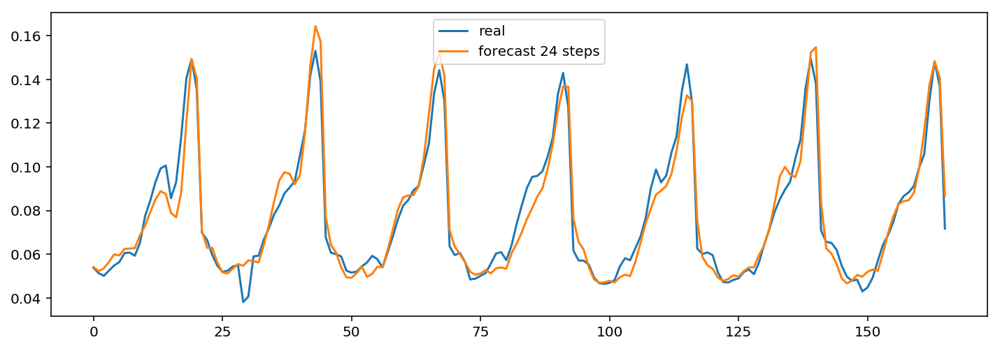

	 	 Forecasting a sample from Learning dataset


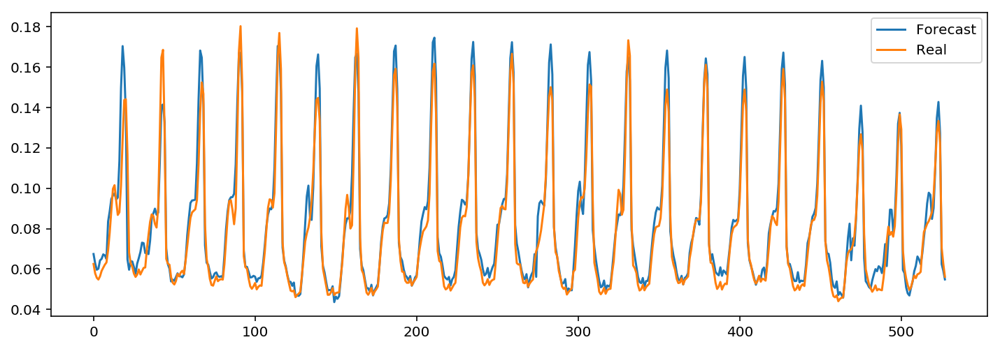

In [26]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 10
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.66136092283 
Daily Learning mean absolute percentage error of 22 days : 7.78209714456 
	 	 MAPError plot through Learning DataSet 


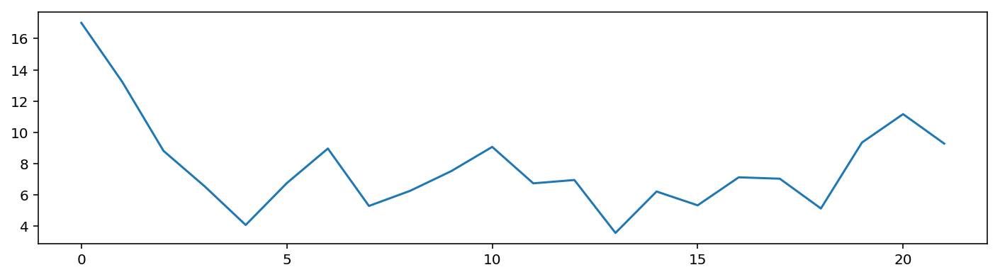

	 	 Test subset results
Test mean absolute percentage error per hour: 4.954538
Test mean absolute percentage error per day: 6.306579 
	 	 Validation Forecasting visualisation


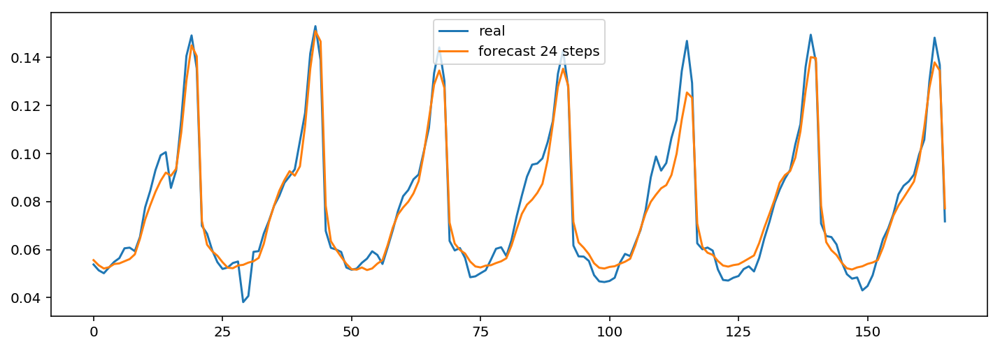

	 	 Forecasting a sample from Learning dataset


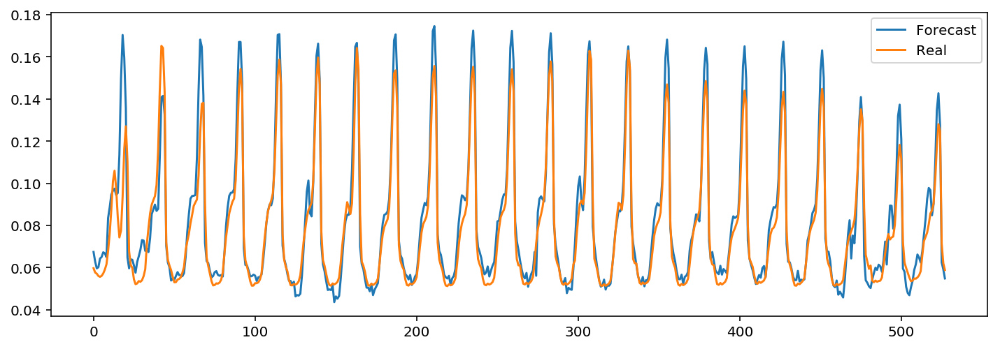

In [27]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 11
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.82503098404 
Daily Learning mean absolute percentage error of 22 days : 5.68046236038 
	 	 MAPError plot through Learning DataSet 


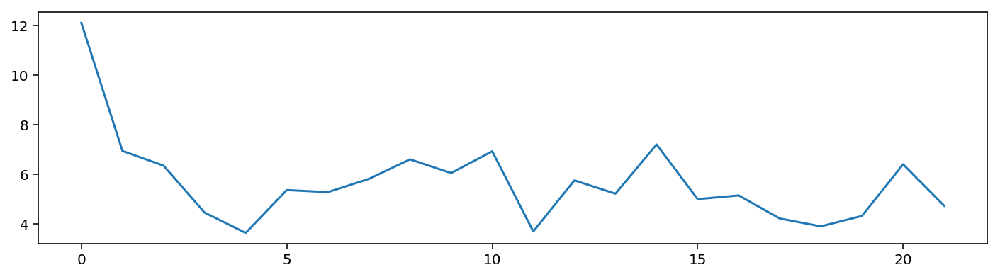

	 	 Test subset results
Test mean absolute percentage error per hour: 5.361456
Test mean absolute percentage error per day: 7.077982 
	 	 Validation Forecasting visualisation


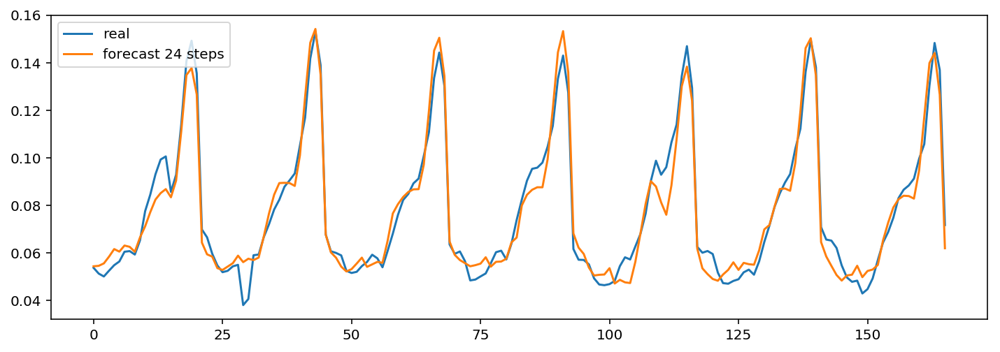

	 	 Forecasting a sample from Learning dataset


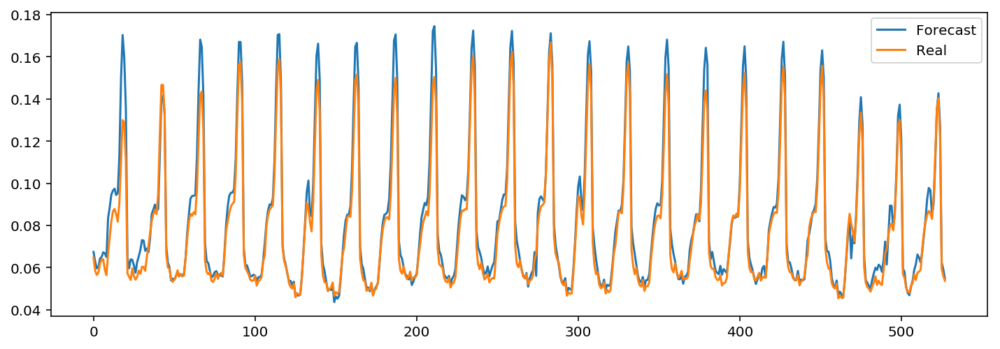

In [28]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 12
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.24295012149 
Daily Learning mean absolute percentage error of 22 days : 4.77234603058 
	 	 MAPError plot through Learning DataSet 


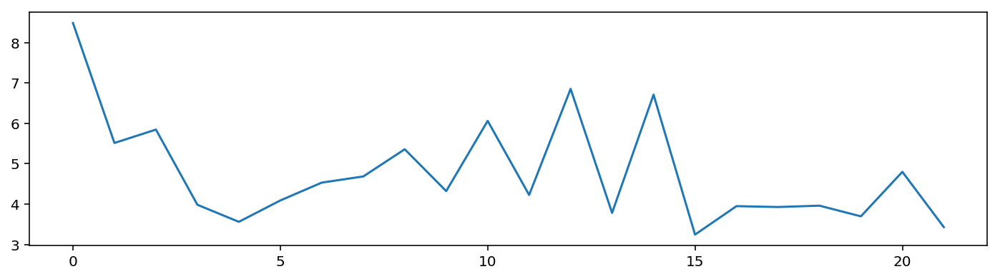

	 	 Test subset results
Test mean absolute percentage error per hour: 5.509110
Test mean absolute percentage error per day: 7.415619 
	 	 Validation Forecasting visualisation


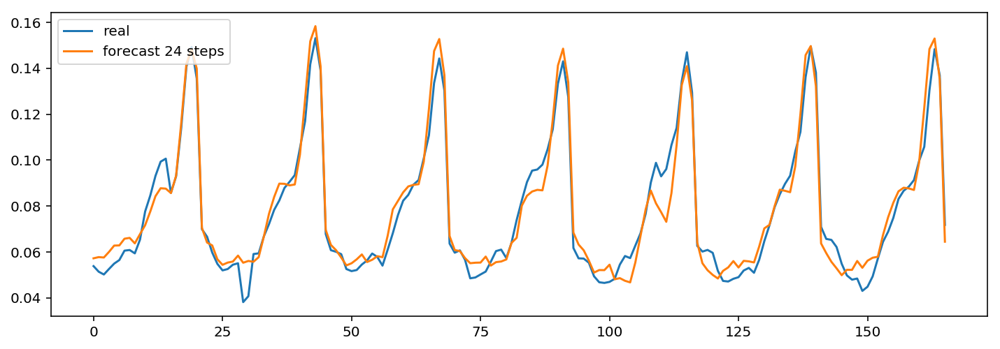

	 	 Forecasting a sample from Learning dataset


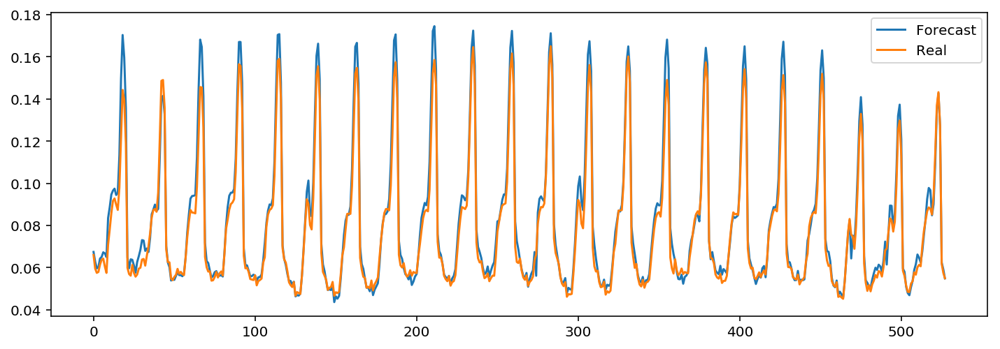

In [29]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 13
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.4656108652 
Daily Learning mean absolute percentage error of 22 days : 4.45048985698 
	 	 MAPError plot through Learning DataSet 


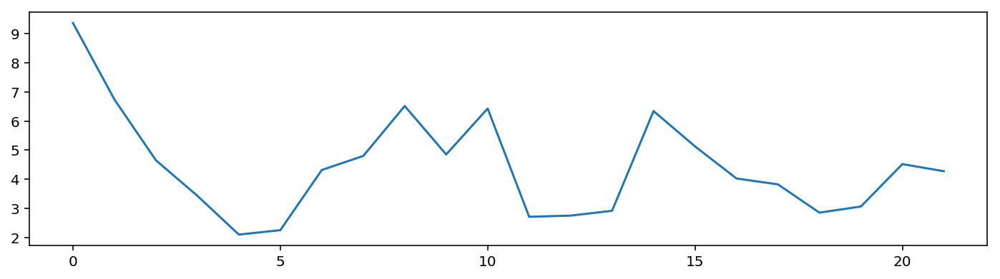

	 	 Test subset results
Test mean absolute percentage error per hour: 5.288751
Test mean absolute percentage error per day: 7.090957 
	 	 Validation Forecasting visualisation


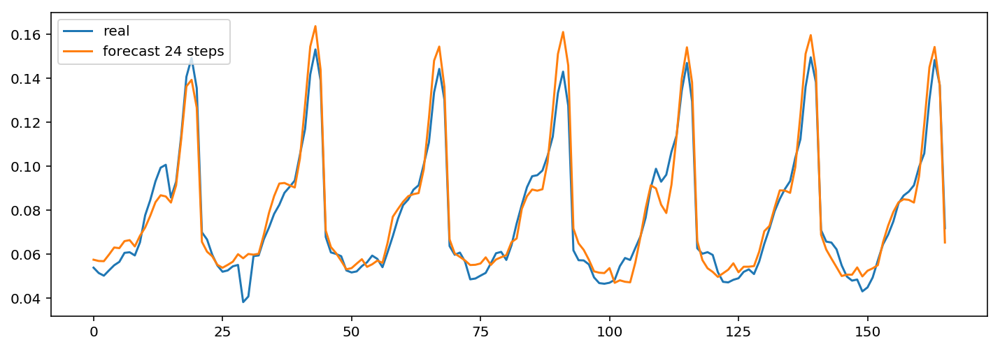

	 	 Forecasting a sample from Learning dataset


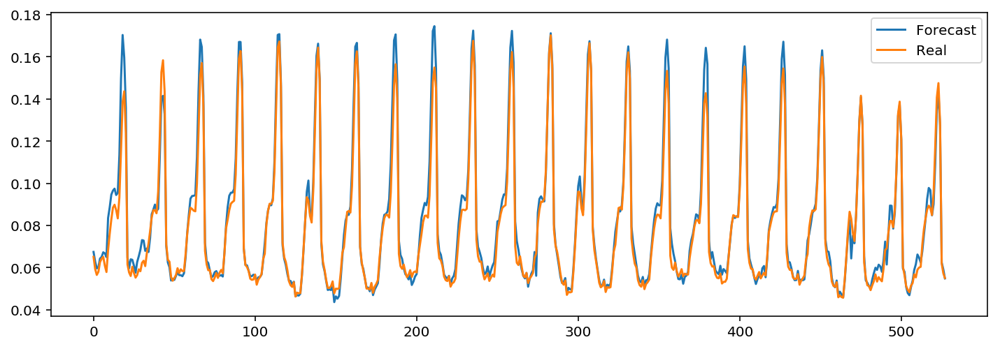

In [30]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 14
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.67194071184 
Daily Learning mean absolute percentage error of 22 days : 4.49166607857 
	 	 MAPError plot through Learning DataSet 


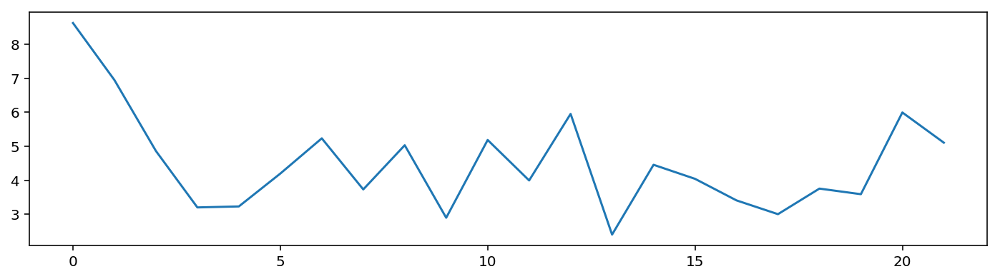

	 	 Test subset results
Test mean absolute percentage error per hour: 5.432375
Test mean absolute percentage error per day: 6.908480 
	 	 Validation Forecasting visualisation


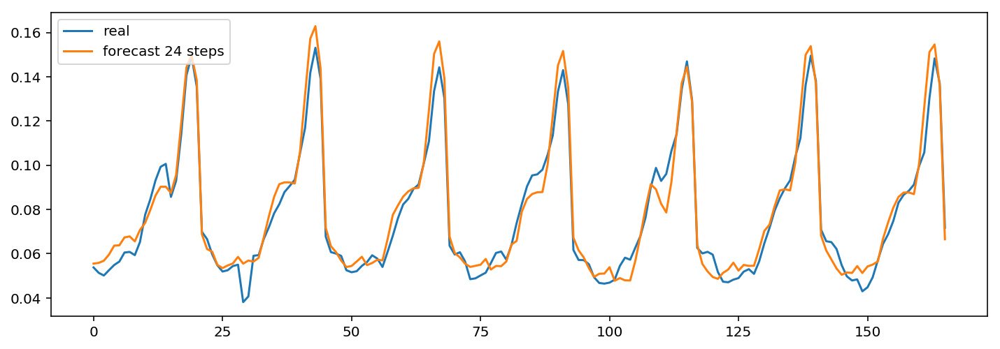

	 	 Forecasting a sample from Learning dataset


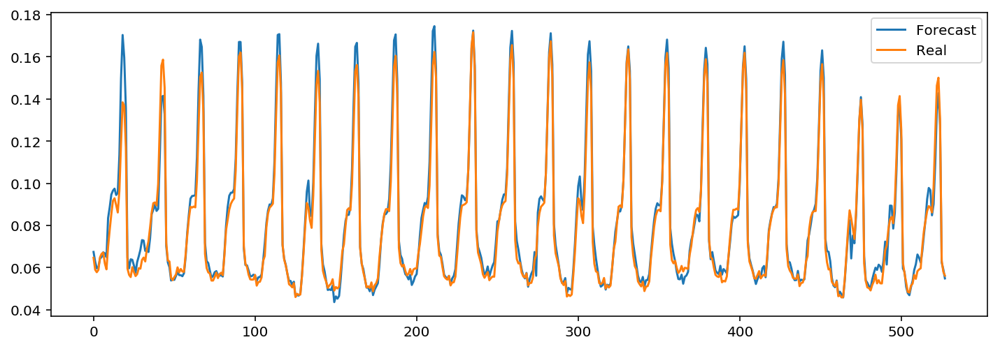

In [31]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')



LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 15
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 3.10499715431 
Daily Learning mean absolute percentage error of 22 days : 6.14312629266 
	 	 MAPError plot through Learning DataSet 


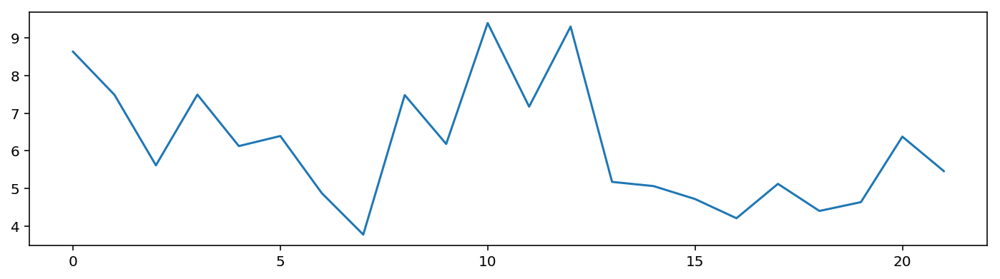

	 	 Test subset results
Test mean absolute percentage error per hour: 5.215281
Test mean absolute percentage error per day: 6.478411 
	 	 Validation Forecasting visualisation


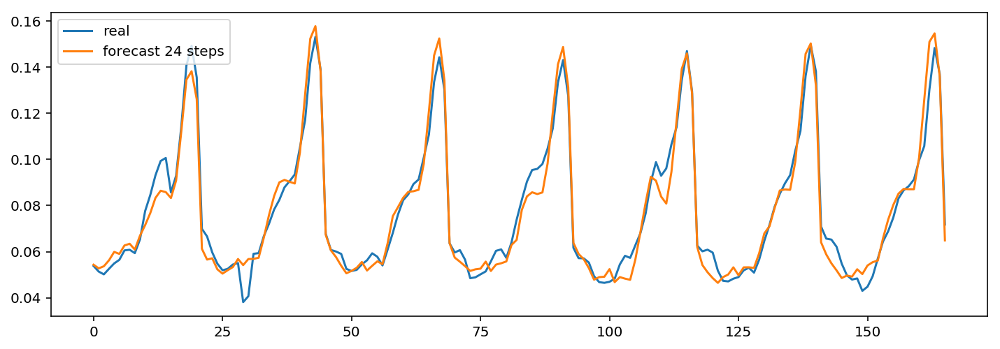

	 	 Forecasting a sample from Learning dataset


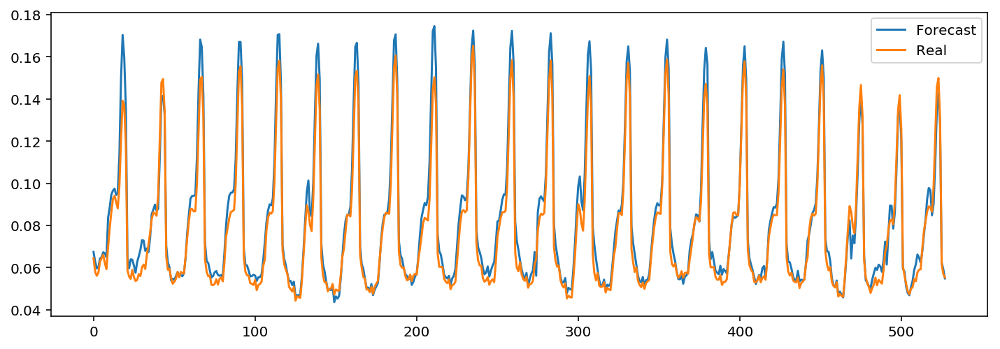

In [32]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 16
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.59002563173 
Daily Learning mean absolute percentage error of 22 days : 4.76712327654 
	 	 MAPError plot through Learning DataSet 


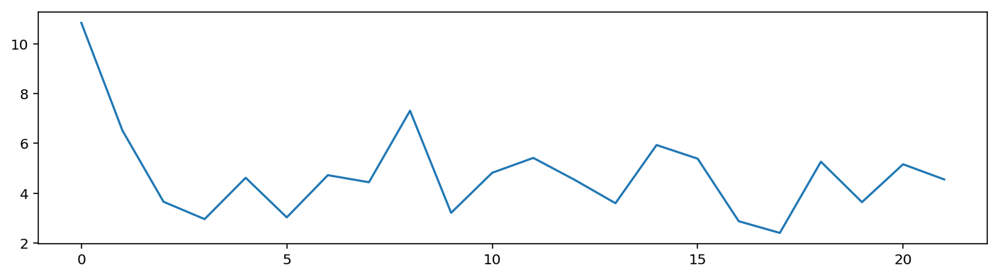

	 	 Test subset results
Test mean absolute percentage error per hour: 5.254620
Test mean absolute percentage error per day: 7.394255 
	 	 Validation Forecasting visualisation


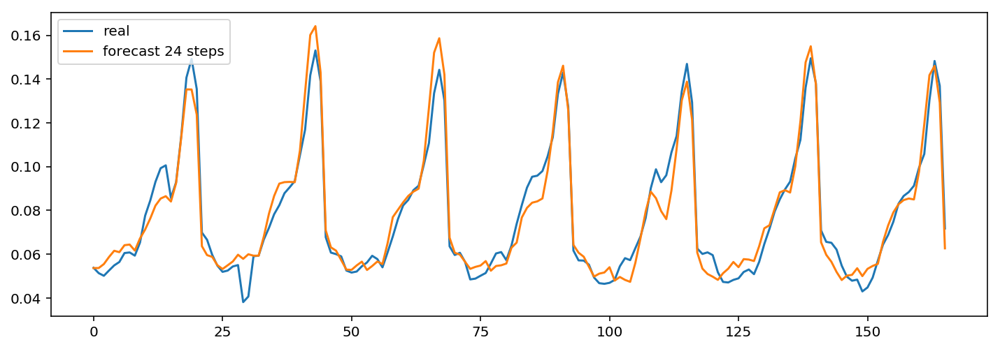

	 	 Forecasting a sample from Learning dataset


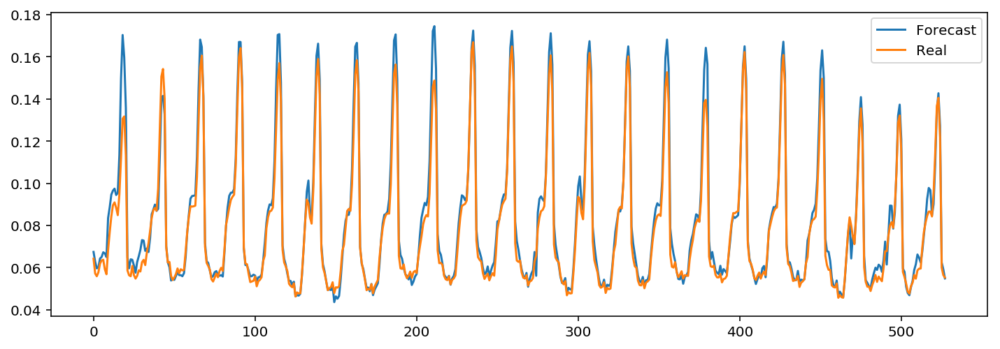

In [33]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = False
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [34]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2906.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.830145,6.610317
1,1.0,20.0,10.0,0.001,2913.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.271002,6.628031
2,2.0,20.0,10.0,0.001,2963.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.429525,6.573019
3,3.0,20.0,10.0,0.001,2911.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.385796,6.609058
4,4.0,20.0,10.0,0.001,2725.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.956918,6.926382
5,5.0,60.0,30.0,0.001,1269.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.159617,7.176886
6,6.0,50.0,10.0,0.001,1638.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.727545,7.626915
7,7.0,80.0,50.0,0.001,1044.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.688553,6.553393
8,8.0,90.0,30.0,0.002,1540.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,5.502599,7.012889
9,9.0,90.0,30.0,0.002,963.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.728009,6.913289


	 	 test num : 17
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 6.37859648302 
Daily Learning mean absolute percentage error of 22 days : 7.49361852082 
	 	 MAPError plot through Learning DataSet 


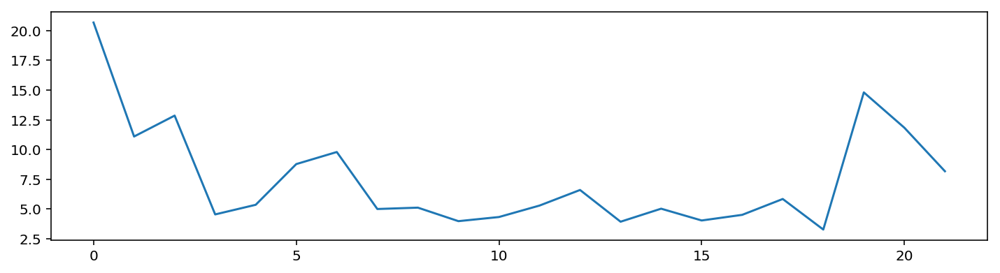

	 	 Test subset results
Test mean absolute percentage error per hour: 5.243662
Test mean absolute percentage error per day: 5.898236 
	 	 Validation Forecasting visualisation


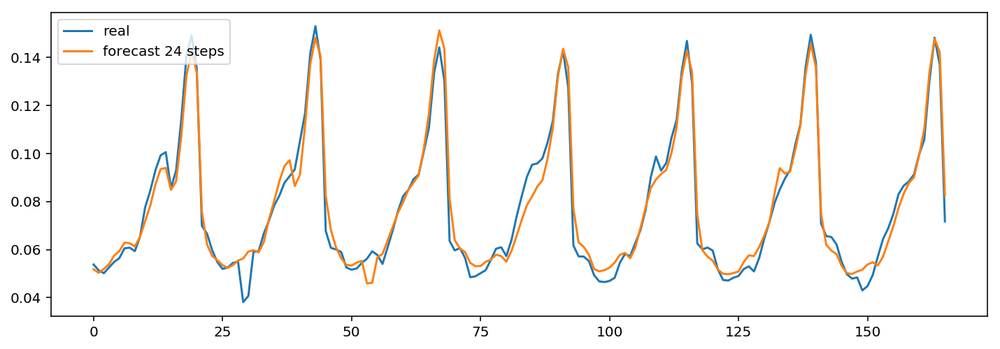

	 	 Forecasting a sample from Learning dataset


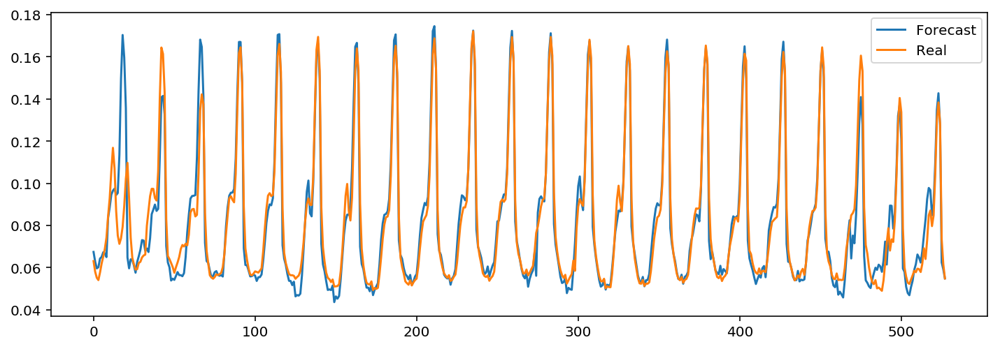

In [36]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 18
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.70716199483 
Daily Learning mean absolute percentage error of 22 days : 7.84646002813 
	 	 MAPError plot through Learning DataSet 


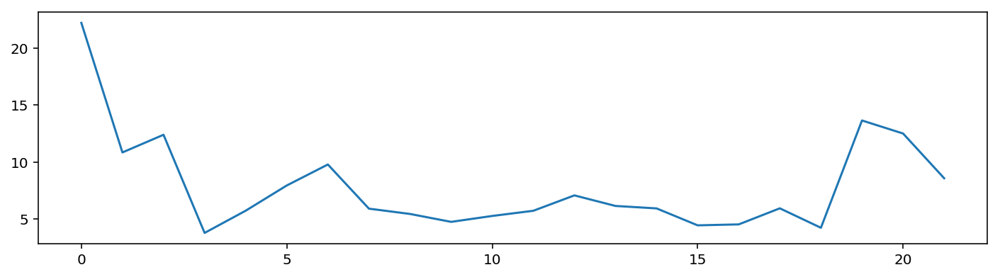

	 	 Test subset results
Test mean absolute percentage error per hour: 4.788343
Test mean absolute percentage error per day: 6.094279 
	 	 Validation Forecasting visualisation


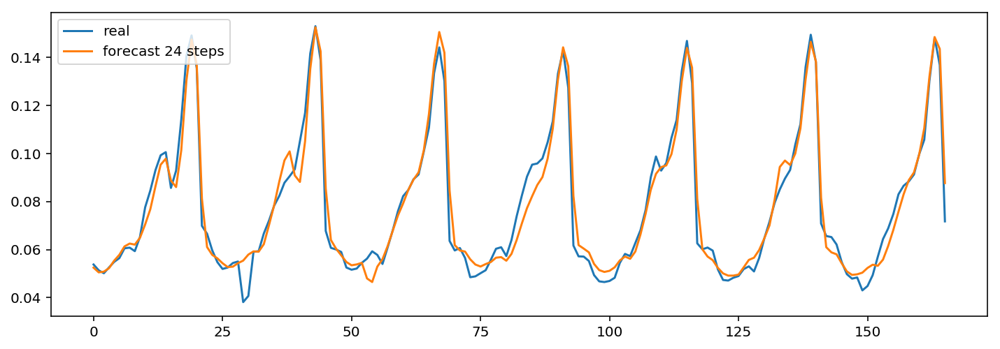

	 	 Forecasting a sample from Learning dataset


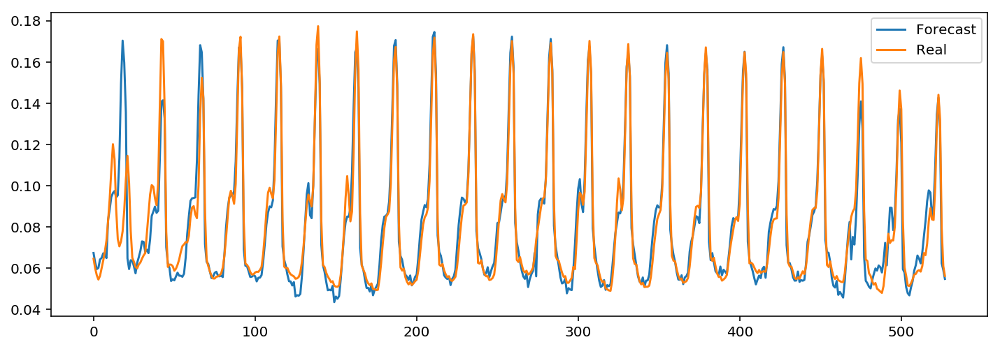

In [37]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 2
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 19
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.27183633573 
Daily Learning mean absolute percentage error of 22 days : 8.92327839678 
	 	 MAPError plot through Learning DataSet 


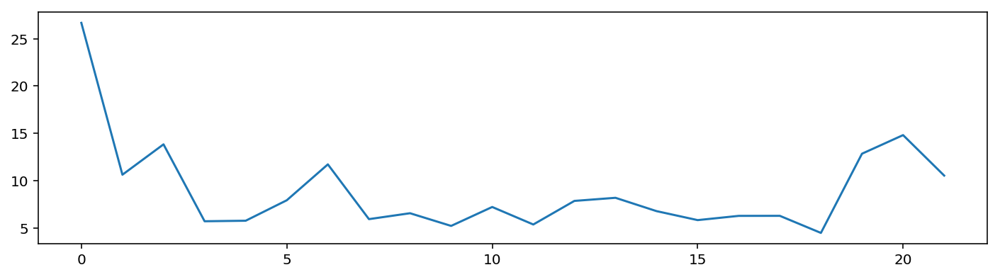

	 	 Test subset results
Test mean absolute percentage error per hour: 4.505249
Test mean absolute percentage error per day: 7.003158 
	 	 Validation Forecasting visualisation


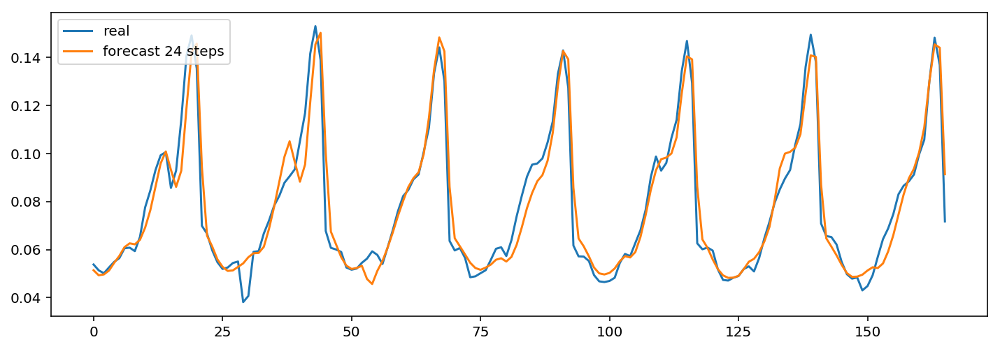

	 	 Forecasting a sample from Learning dataset


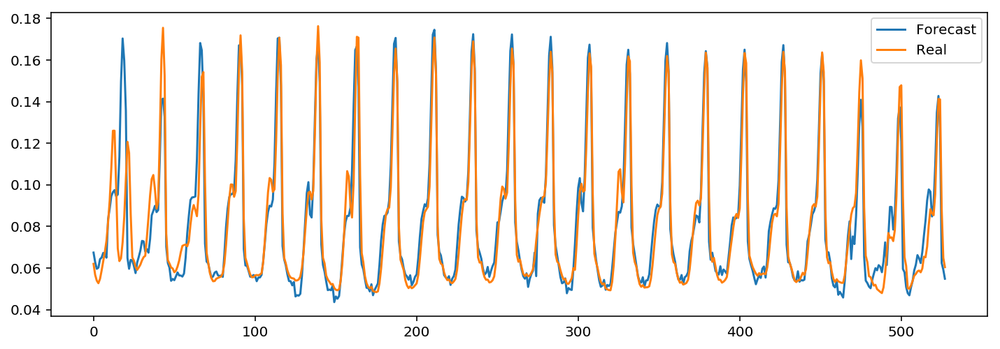

In [38]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 20
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.48666009596 
Daily Learning mean absolute percentage error of 22 days : 8.94868469238 
	 	 MAPError plot through Learning DataSet 


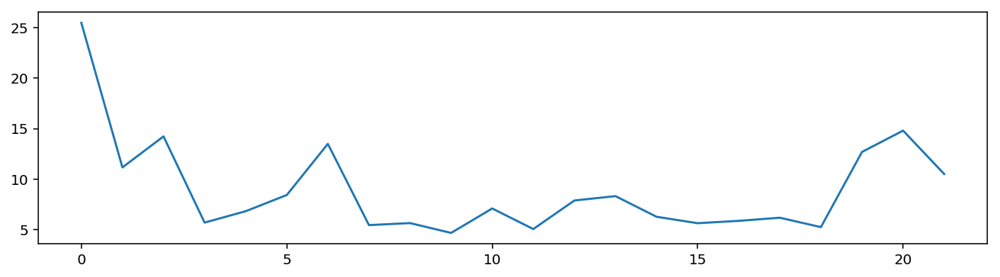

	 	 Test subset results
Test mean absolute percentage error per hour: 4.596249
Test mean absolute percentage error per day: 7.048586 
	 	 Validation Forecasting visualisation


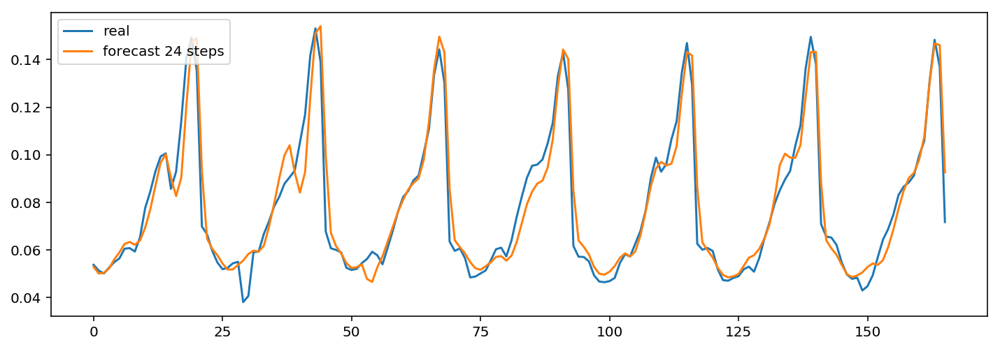

	 	 Forecasting a sample from Learning dataset


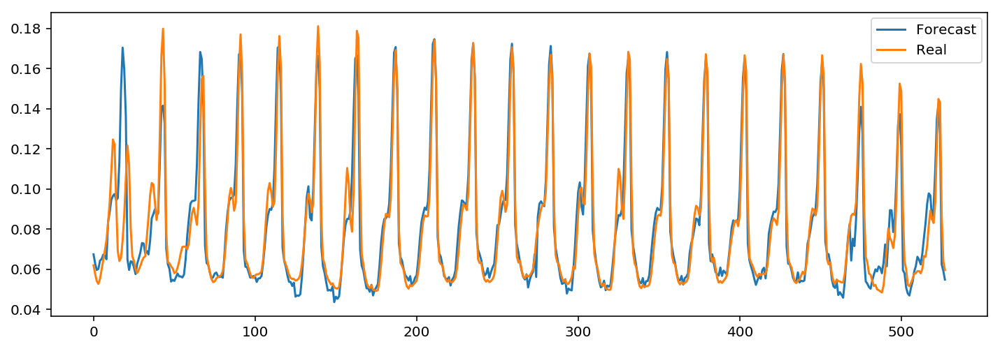

In [39]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 4
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 21
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.26655073097 
Daily Learning mean absolute percentage error of 22 days : 8.98368367282 
	 	 MAPError plot through Learning DataSet 


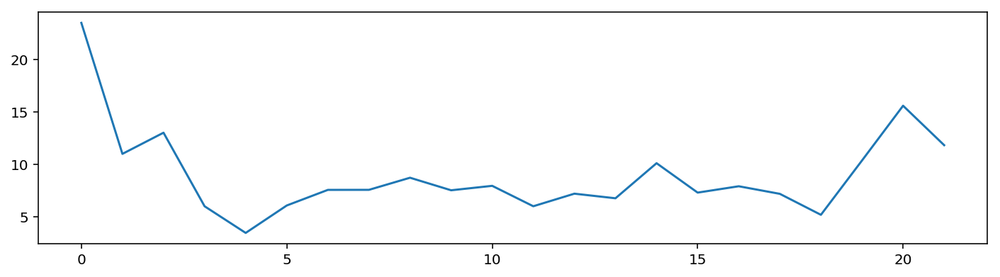

	 	 Test subset results
Test mean absolute percentage error per hour: 4.512259
Test mean absolute percentage error per day: 7.717085 
	 	 Validation Forecasting visualisation


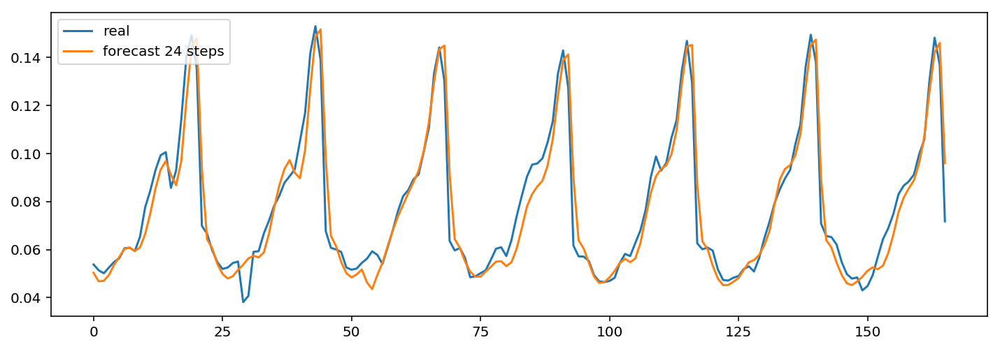

	 	 Forecasting a sample from Learning dataset


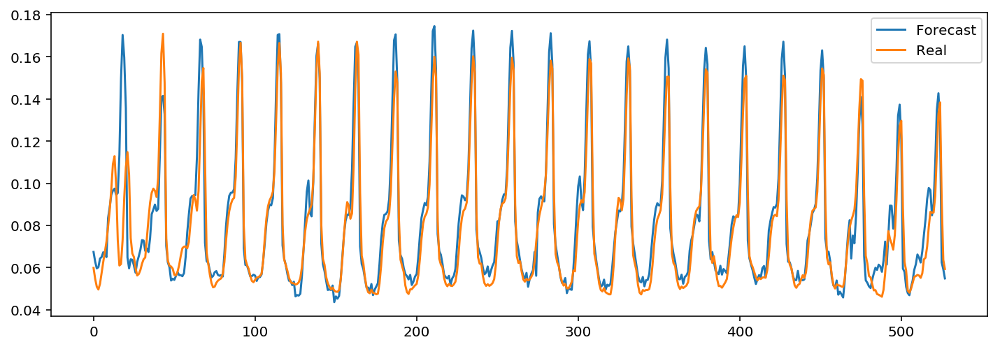

In [40]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 5
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 22
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.74163171603 
Daily Learning mean absolute percentage error of 22 days : 8.05898020484 
	 	 MAPError plot through Learning DataSet 


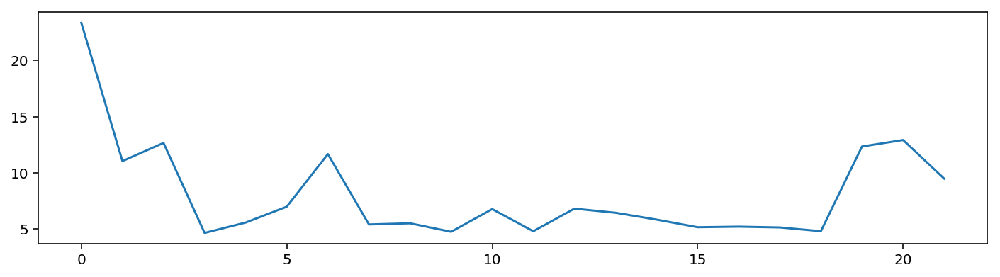

	 	 Test subset results
Test mean absolute percentage error per hour: 4.779114
Test mean absolute percentage error per day: 6.477040 
	 	 Validation Forecasting visualisation


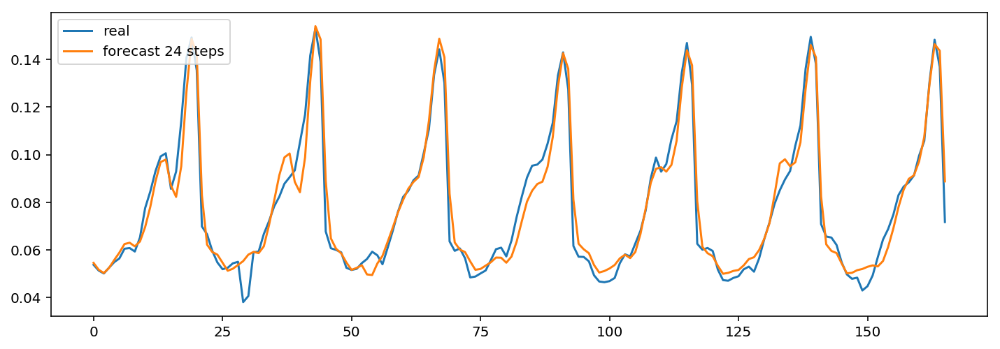

	 	 Forecasting a sample from Learning dataset


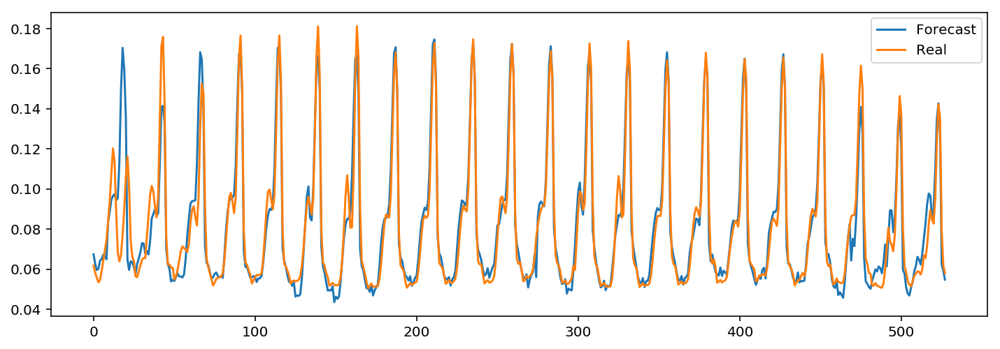

In [41]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 23
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.36284189994 
Daily Learning mean absolute percentage error of 22 days : 9.09023707563 
	 	 MAPError plot through Learning DataSet 


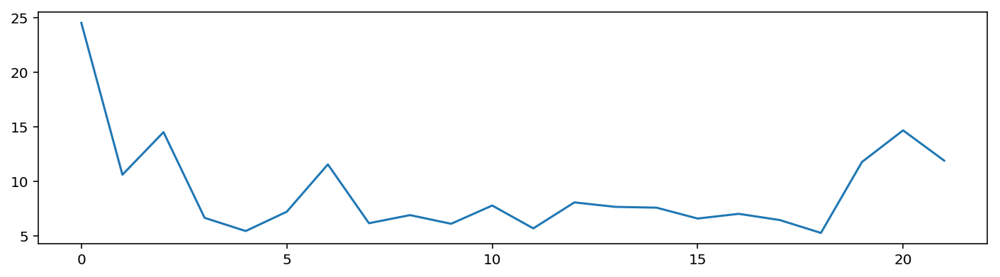

	 	 Test subset results
Test mean absolute percentage error per hour: 4.677561
Test mean absolute percentage error per day: 7.484931 
	 	 Validation Forecasting visualisation


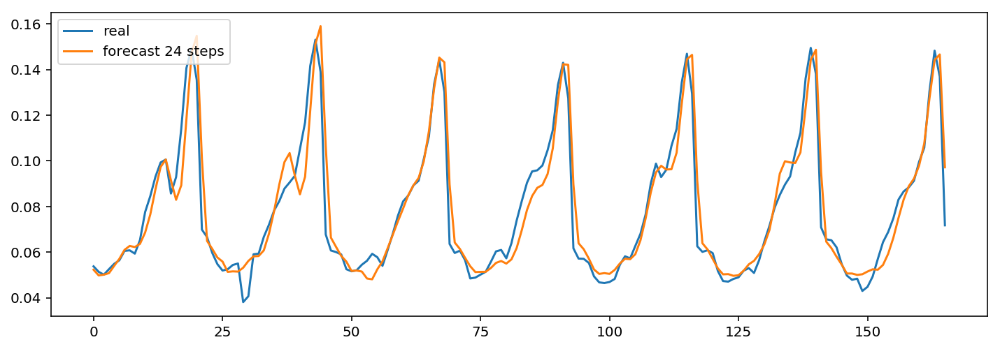

	 	 Forecasting a sample from Learning dataset


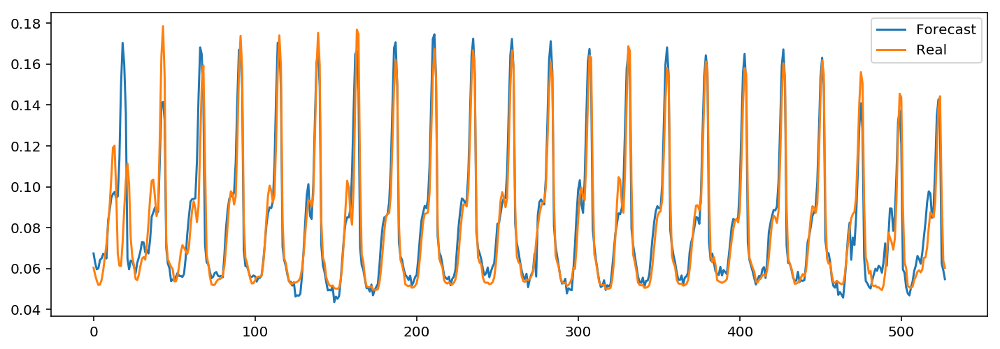

In [42]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 7
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 24
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.52474879779 
Daily Learning mean absolute percentage error of 22 days : 8.90221216462 
	 	 MAPError plot through Learning DataSet 


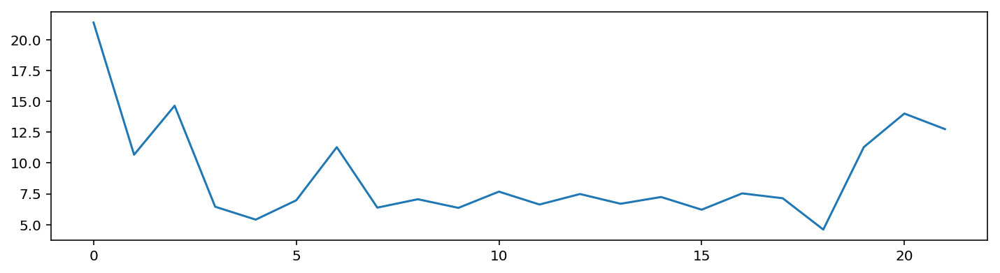

	 	 Test subset results
Test mean absolute percentage error per hour: 4.891412
Test mean absolute percentage error per day: 7.558722 
	 	 Validation Forecasting visualisation


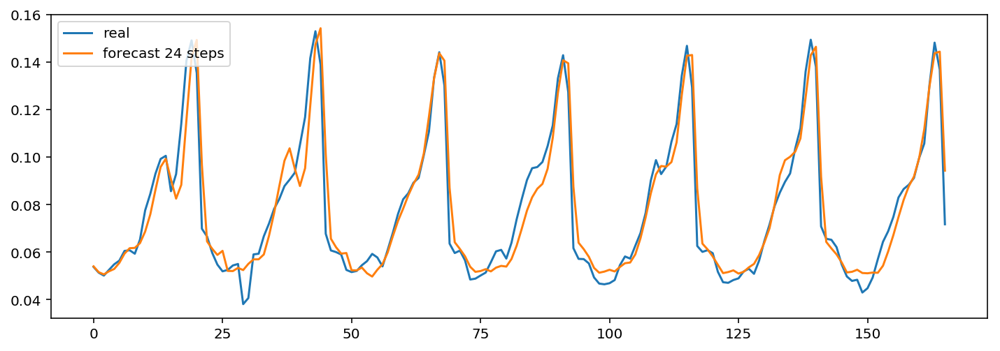

	 	 Forecasting a sample from Learning dataset


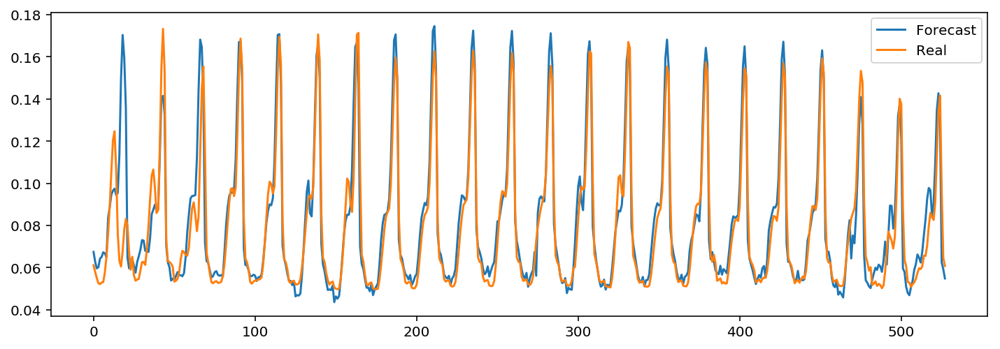

In [43]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 8
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 25
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.78420252318 
Daily Learning mean absolute percentage error of 22 days : 8.18593094566 
	 	 MAPError plot through Learning DataSet 


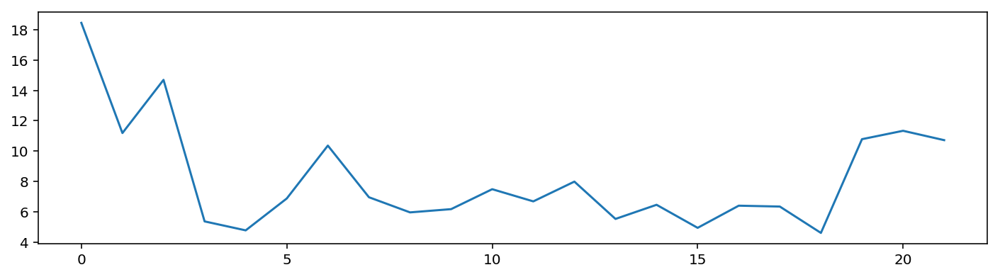

	 	 Test subset results
Test mean absolute percentage error per hour: 5.128527
Test mean absolute percentage error per day: 6.711616 
	 	 Validation Forecasting visualisation


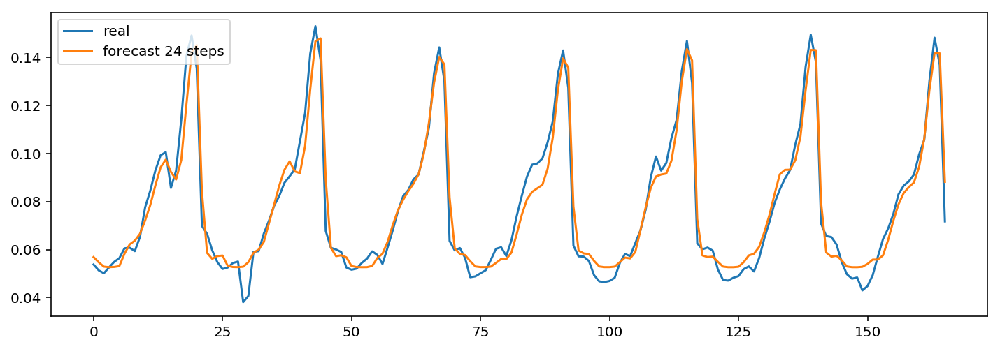

	 	 Forecasting a sample from Learning dataset


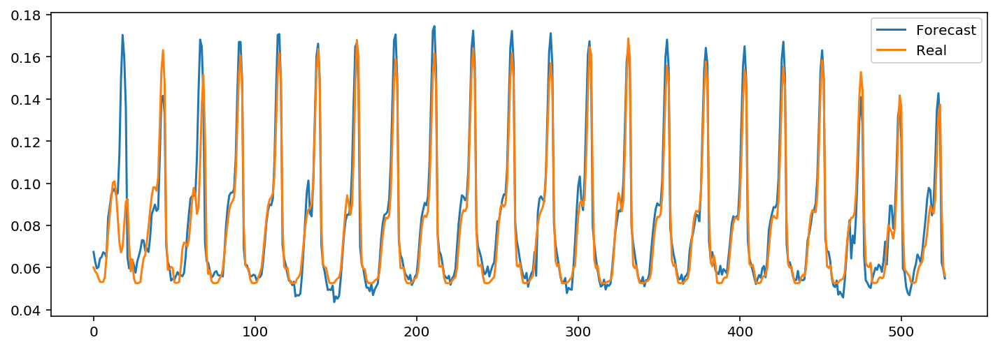

In [44]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 9
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 26
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 6.06638357368 
Daily Learning mean absolute percentage error of 22 days : 8.6678797115 
	 	 MAPError plot through Learning DataSet 


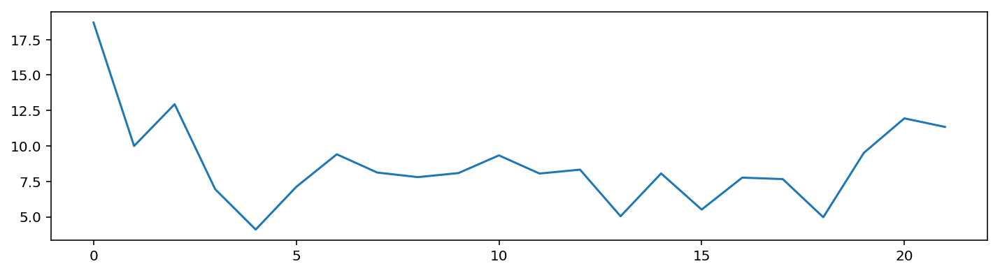

	 	 Test subset results
Test mean absolute percentage error per hour: 5.134541
Test mean absolute percentage error per day: 6.903570 
	 	 Validation Forecasting visualisation


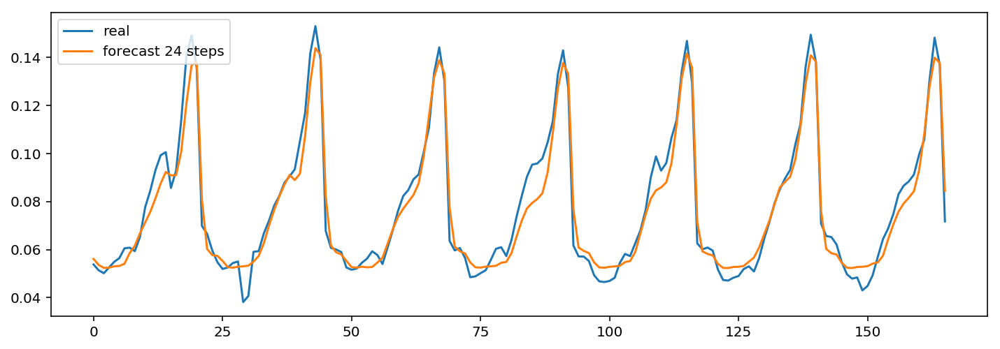

	 	 Forecasting a sample from Learning dataset


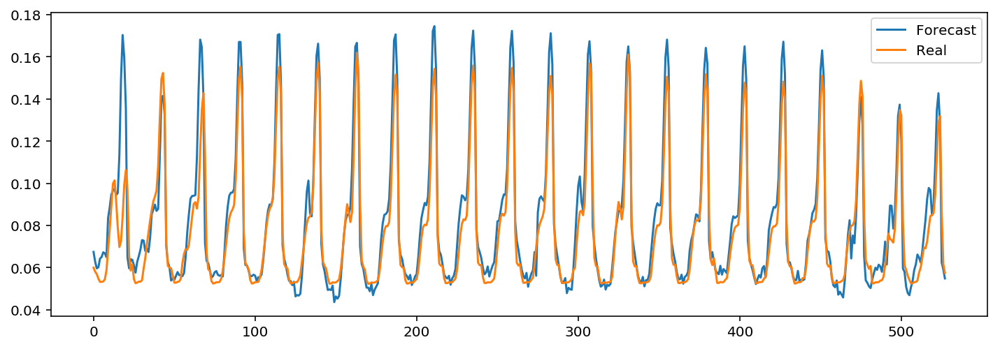

In [45]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 10
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 27
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.50673042572 
Daily Learning mean absolute percentage error of 22 days : 8.50579874082 
	 	 MAPError plot through Learning DataSet 


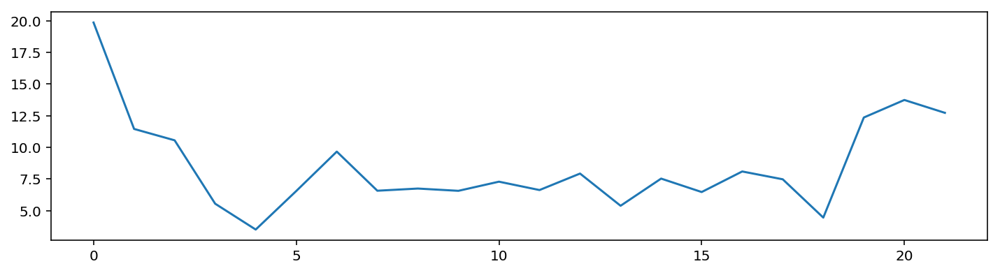

	 	 Test subset results
Test mean absolute percentage error per hour: 4.675025
Test mean absolute percentage error per day: 6.748163 
	 	 Validation Forecasting visualisation


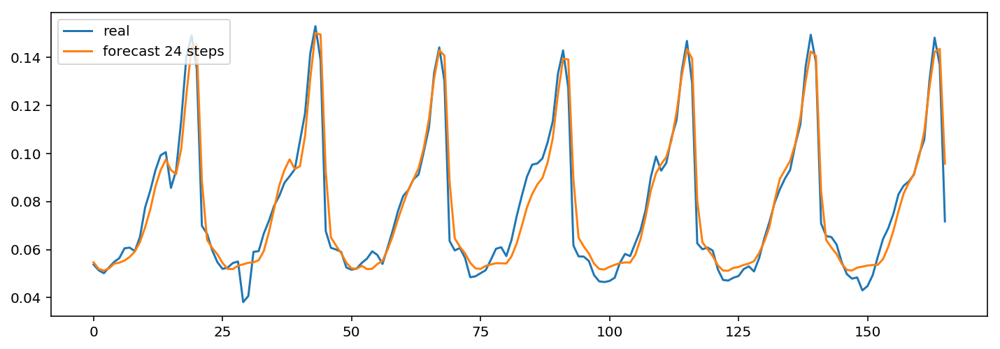

	 	 Forecasting a sample from Learning dataset


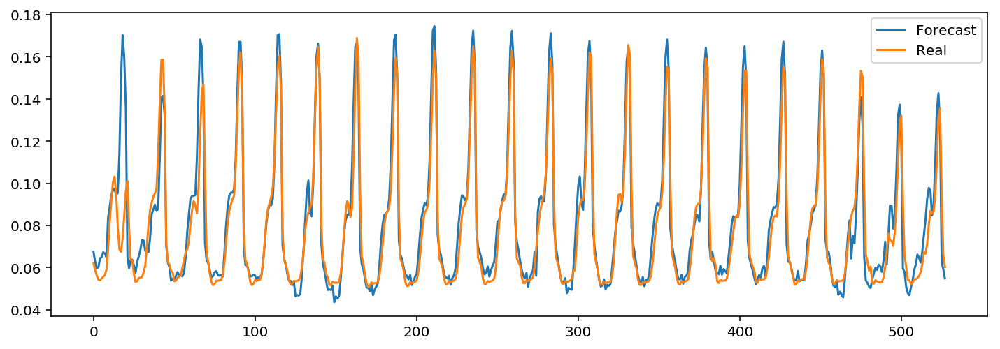

In [46]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 11
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 28
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 5.88329395967 
Daily Learning mean absolute percentage error of 22 days : 7.77104430849 
	 	 MAPError plot through Learning DataSet 


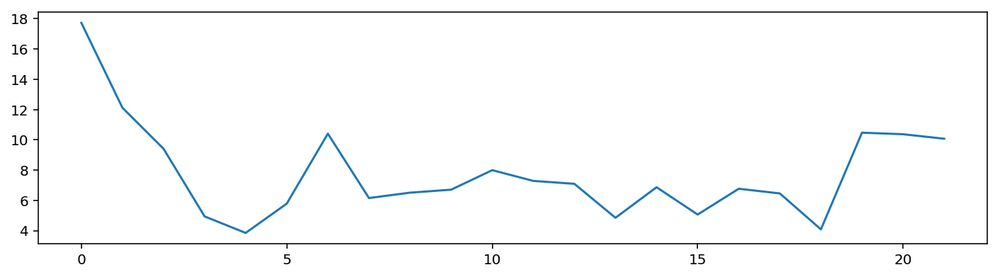

	 	 Test subset results
Test mean absolute percentage error per hour: 4.803512
Test mean absolute percentage error per day: 6.154292 
	 	 Validation Forecasting visualisation


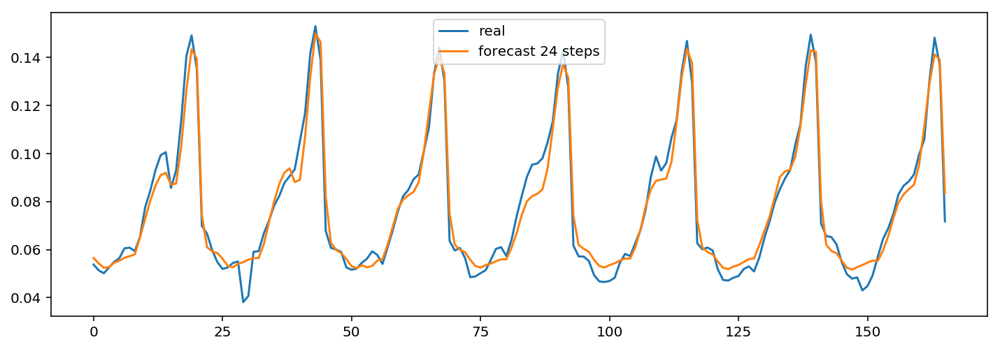

	 	 Forecasting a sample from Learning dataset


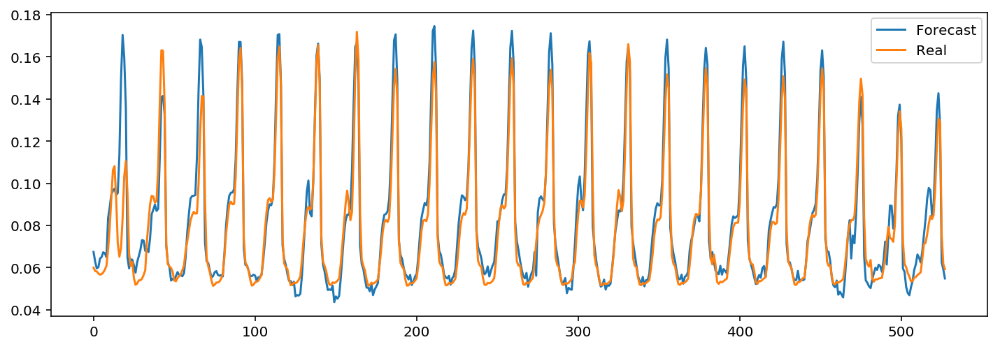

In [47]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [48]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2906.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.830145,6.610317
1,1.0,20.0,10.0,0.001,2913.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.271002,6.628031
2,2.0,20.0,10.0,0.001,2963.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.429525,6.573019
3,3.0,20.0,10.0,0.001,2911.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.385796,6.609058
4,4.0,20.0,10.0,0.001,2725.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.956918,6.926382
5,5.0,60.0,30.0,0.001,1269.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.159617,7.176886
6,6.0,50.0,10.0,0.001,1638.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.727545,7.626915
7,7.0,80.0,50.0,0.001,1044.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.688553,6.553393
8,8.0,90.0,30.0,0.002,1540.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,5.502599,7.012889
9,9.0,90.0,30.0,0.002,963.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.728009,6.913289


	 	 test num : 29
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.58206351564 
Daily Learning mean absolute percentage error of 22 days : 4.28143221682 
	 	 MAPError plot through Learning DataSet 


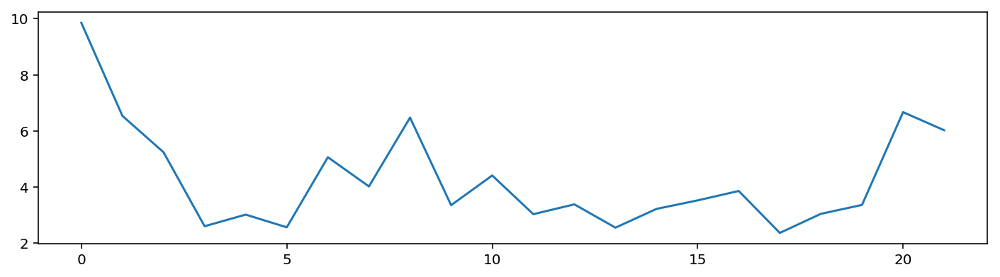

	 	 Test subset results
Test mean absolute percentage error per hour: 4.858581
Test mean absolute percentage error per day: 6.637801 
	 	 Validation Forecasting visualisation


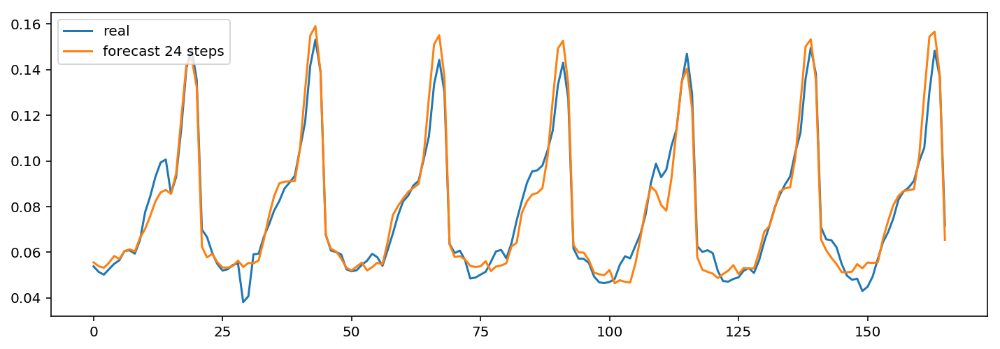

	 	 Forecasting a sample from Learning dataset


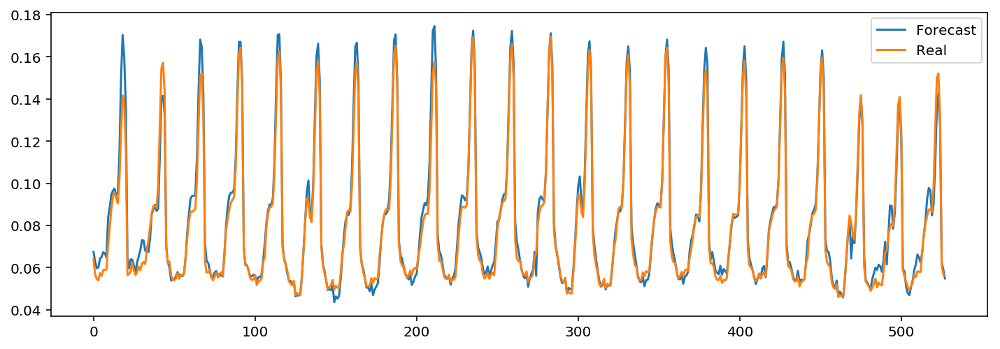

In [49]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 30
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.52017424231 
Daily Learning mean absolute percentage error of 22 days : 4.11860327287 
	 	 MAPError plot through Learning DataSet 


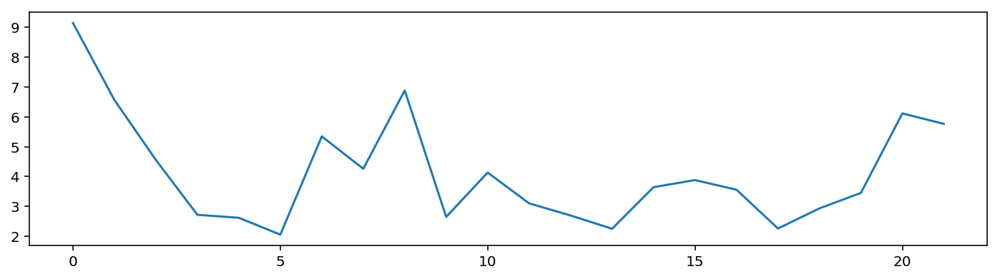

	 	 Test subset results
Test mean absolute percentage error per hour: 5.096079
Test mean absolute percentage error per day: 6.598993 
	 	 Validation Forecasting visualisation


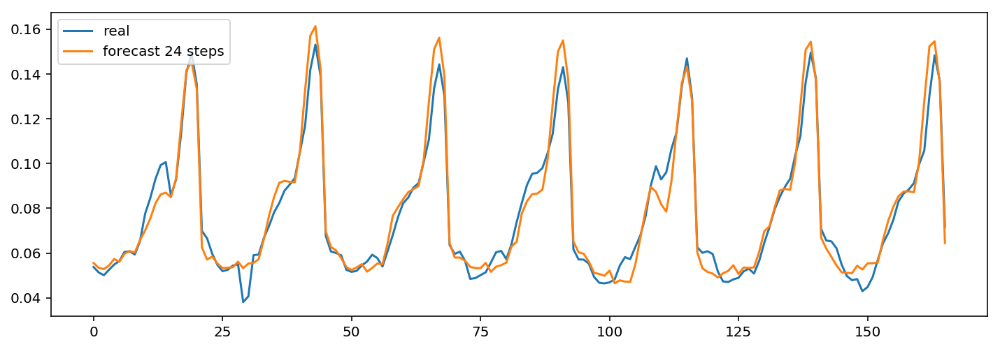

	 	 Forecasting a sample from Learning dataset


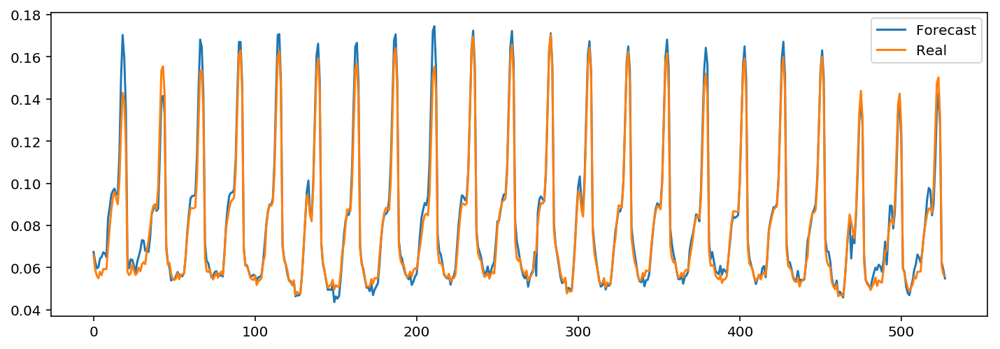

In [50]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 2
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 31
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.57357871896 
Daily Learning mean absolute percentage error of 22 days : 4.41982735287 
	 	 MAPError plot through Learning DataSet 


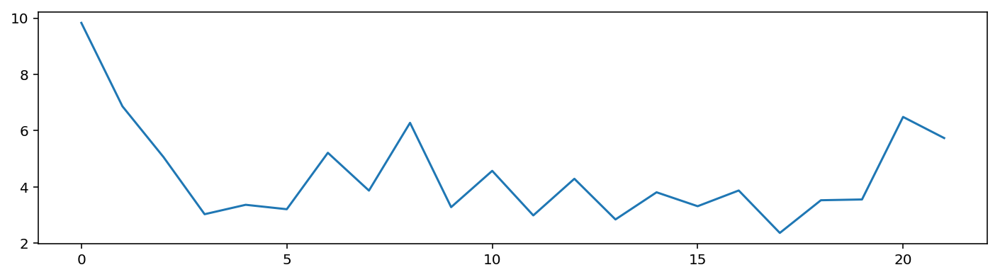

	 	 Test subset results
Test mean absolute percentage error per hour: 5.050416
Test mean absolute percentage error per day: 6.704572 
	 	 Validation Forecasting visualisation


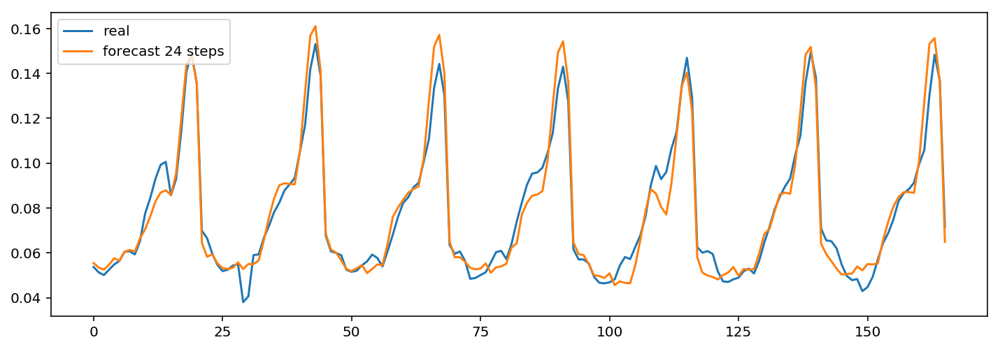

	 	 Forecasting a sample from Learning dataset


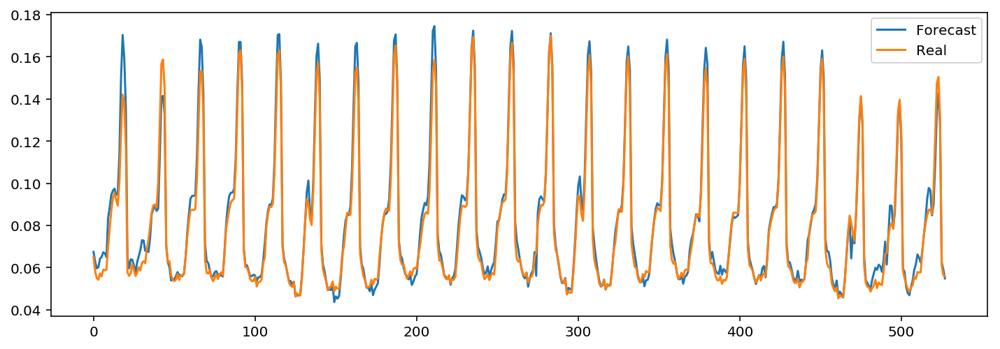

In [51]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 32
	 	 learning subset results
Hourly Learning mean absolute percentage error of 528 hours : 2.47827215018 
Daily Learning mean absolute percentage error of 22 days : 3.76640803164 
	 	 MAPError plot through Learning DataSet 


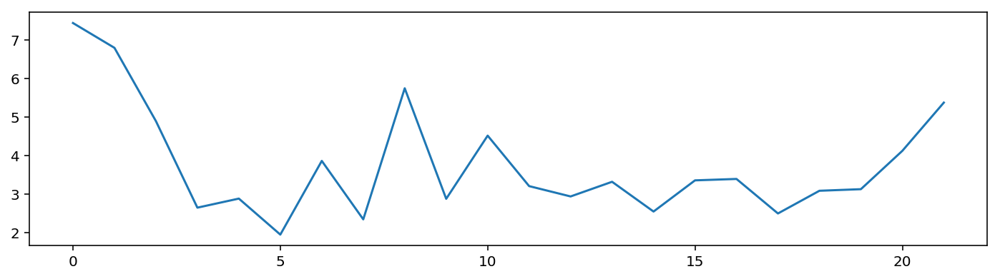

	 	 Test subset results
Test mean absolute percentage error per hour: 5.263355
Test mean absolute percentage error per day: 7.316452 
	 	 Validation Forecasting visualisation


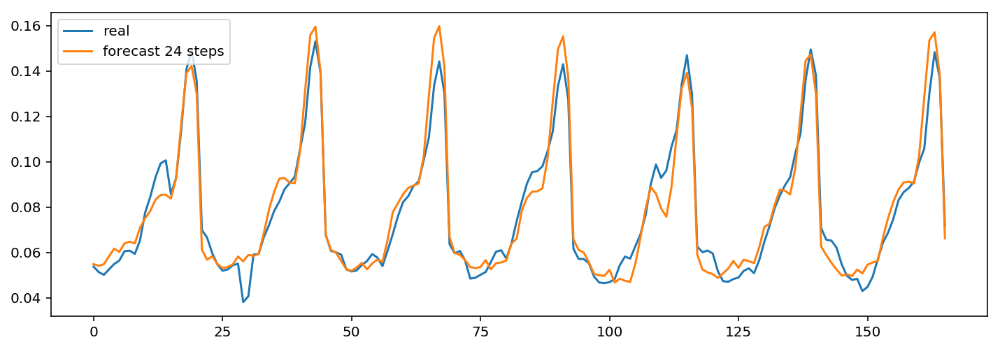

	 	 Forecasting a sample from Learning dataset


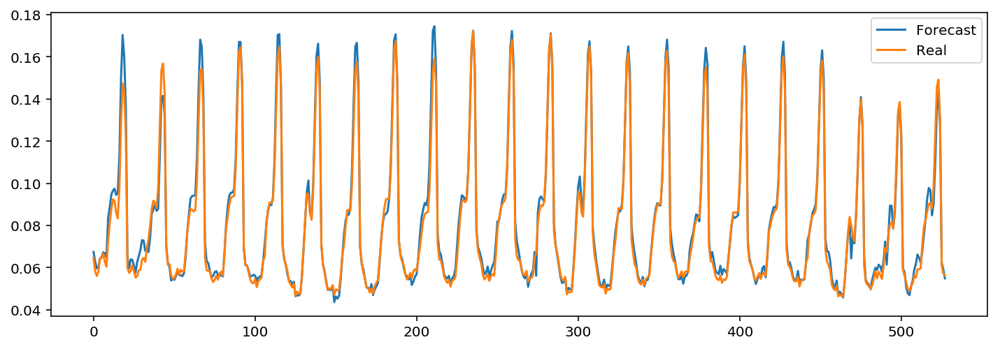

In [52]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 24
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [53]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2906.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.830145,6.610317
1,1.0,20.0,10.0,0.001,2913.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.271002,6.628031
2,2.0,20.0,10.0,0.001,2963.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.429525,6.573019
3,3.0,20.0,10.0,0.001,2911.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.385796,6.609058
4,4.0,20.0,10.0,0.001,2725.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.956918,6.926382
5,5.0,60.0,30.0,0.001,1269.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.159617,7.176886
6,6.0,50.0,10.0,0.001,1638.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.727545,7.626915
7,7.0,80.0,50.0,0.001,1044.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.688553,6.553393
8,8.0,90.0,30.0,0.002,1540.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,5.502599,7.012889
9,9.0,90.0,30.0,0.002,963.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.728009,6.913289


In [54]:
testPeriod= 144

In [11]:
def prepareInputs(daydata, season, UsedInputs,testPeriod):
    nbrInputs= 0
    
    previousHours = UsedInputs[0]
    timeSteps = int(UsedInputs[1])
    previousDay = UsedInputs[2]
    previousWeek = UsedInputs[3]
    temp = UsedInputs[4]
    tempMax = UsedInputs[5]
    tempMin = UsedInputs[6]
    dayIndicator = UsedInputs[7]
    HourIndicator= UsedInputs[8]
    print timeSteps
    if previousHours == True: 
        nbrInputs = nbrInputs + int(timeSteps)
    if previousDay == True: nbrInputs= nbrInputs+1
    if previousWeek == True : nbrInputs= nbrInputs+ 1
    if temp == True: nbrInputs= nbrInputs+1
    if tempMax == True: nbrInputs= nbrInputs+1
    if tempMin == True: nbrInputs= nbrInputs+1
    if dayIndicator== True: nbrInputs= nbrInputs+7
    if HourIndicator== True : nbrInputs= nbrInputs+24
    
    hourclusters= np.empty([(daydata.index.size*24),1])

    hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

    for x in range(0,daydata.index.size):
        for y in range(0,24):
            hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
    hourclusters.size

    tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
    tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
    tempnp= np.array(tempA)
    tempnp= tempnp.reshape(-1,1)
    tempdata= pd.DataFrame(tempnp)

    tempmax= tempAlgiers.loc[:,'Tmax']
    tempmin= tempAlgiers.loc[:,'Tmin']




    tempmx= np.random.random([tempmax.size*24,1])
    tempmn= np.random.random([tempmin.size*24,1])



    for x in range(0,tempmax.size):
        for y in range(0,24):
            tempmx[(x * 24) + y,0] = tempmax.iloc[x]

    for x in range(0,tempmin.size):
        for y in range(0,24):
            tempmn[(x * 24) + y,0] = tempmin.iloc[x]
        

    samples = daydata.index.size*24
    daydata2= daydata.copy()
    del(daydata2['cluster'])

    data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

    maxcons= data.values.max()
    mincons= data.values.min()

    maxtemp= np.max(tempdata.values)
    mintemp= tempdata.values.min()

    maxtempmax= np.max(tempmx)
    mintempmax= np.min(tempmx)

    maxtempmin= np.max(tempmn)
    mintempmin= np.min(tempmn)

    sigxx= np.empty((samples - 168 , nbrInputs))
    sigyy= np.empty((samples - 168 , 1))

    i= 0
    for x in list(range(168,samples)):
        i=0
        if previousHours == True: 
            for y in list(range(timeSteps)):
                sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
                i= i + 1
        if previousDay == True: 
            sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
            i= i+1
        if previousWeek == True : 
            sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
            i= i+ 1
        if temp == True: 
            sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
            i= i+1
        if tempMax == True: 
            sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
            i= i+1
        if tempMin == True: 
            sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
            i= i+1
        if dayIndicator == True:
            ind=0
            for y in range(0,7):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
            i = i + 7
        if HourIndicator == True:
            ind=0
            for y in range(0,24):
                sigxx[x - 168 , i+ind]= 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].hour]=1
        
    
    for x in list(range(168,samples)):
        sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

    sigmoidxx= df(sigxx.copy())
    sigmoidyy= df(sigyy.copy())

    sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
    sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

    sigmoidxx['cluster'] = hourclusters[168:]
    sigmoidyy['cluster'] = hourclusters[168:]
    dfhourclusters = df(hourclusters)
    
    SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()
    
    SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
    del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
    
    learninginputs = pd.DataFrame(columns=SigmoidInputs.columns)
    learningoutputs = pd.DataFrame(columns=SigmoidOutputs.columns)           
    testinputs = pd.DataFrame(columns=SigmoidInputs.columns)
    testoutputs = pd.DataFrame(columns=SigmoidOutputs.columns)
    y=0

    learninginputs=learninginputs.append(SigmoidInputs.iloc[: 48])
    learningoutputs=learningoutputs.append(SigmoidOutputs.iloc[: 48])
    z=0
    for x in range(testPeriod/24):
        
        
        testinputs=testinputs.append(SigmoidInputs.iloc[ 48  + y : 48 + 24 + y])
        testoutputs=testoutputs.append(SigmoidOutputs.iloc[ 48  + y : 48 + 24 + y])
        z= 48 + 24 + y
        learninginputs=learninginputs.append(SigmoidInputs.iloc[z: z + 72])
        learningoutputs=learningoutputs.append(SigmoidOutputs.iloc[z: z + 72])

        y= y + 120
        
    learninginputs=learninginputs.append(SigmoidInputs.iloc[z- 120: SigmoidInputs.size])
    learningoutputs=learningoutputs.append(SigmoidOutputs.iloc[z-120: SigmoidInputs.size])

    
#     learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
#                             index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
#     testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
#                             index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

#     learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
#                             index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
#     testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
#                             index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    print('-------Input preparation process complet-------')
    return learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs

	 	 learning subset results
Hourly Learning mean absolute percentage error of 456 hours : 2.95154367348 
Daily Learning mean absolute percentage error of 19 days : 4.65103785615 
	 	 MAPError plot through Learning DataSet 


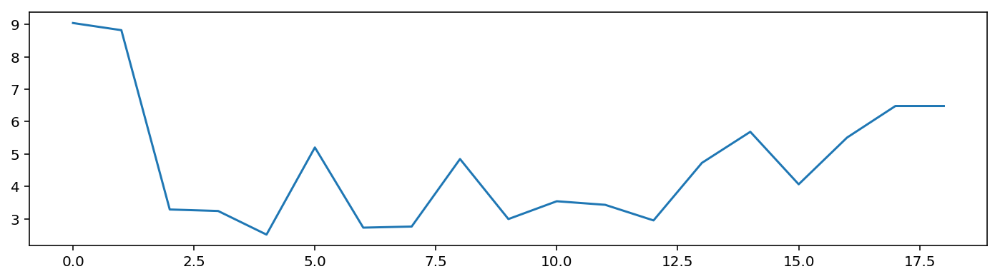

	 	 Test subset results
Test mean absolute percentage error per hour: 3.575163
Test mean absolute percentage error per day: 5.150482 
	 	 Validation Forecasting visualisation


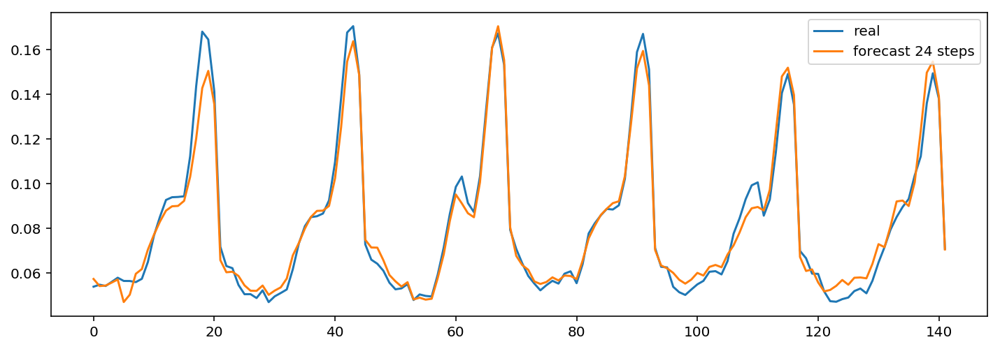

	 	 Forecasting a sample from Learning dataset


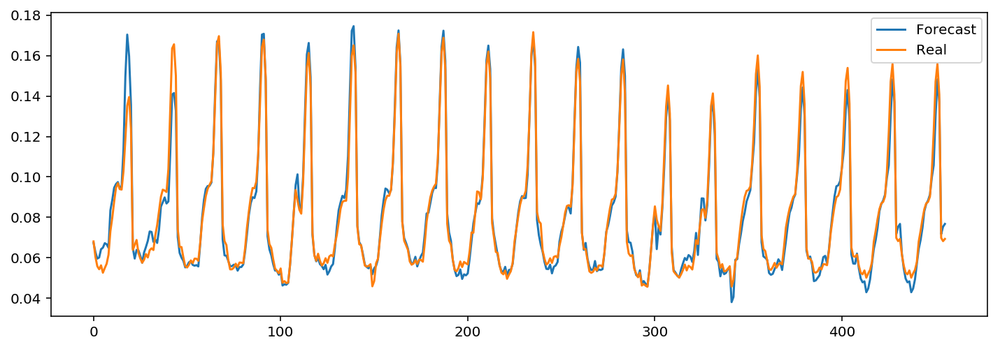

In [95]:
# UsedInputsTemp= np.empty([9])
# FinalErrorTemp= np.empty([2])
# Parameters = np.empty([4])
# ID= np.empty([1])
# ID[0]=Model_ID


# UsedInputsTemp[0] = previoushour = True
# UsedInputsTemp[1] = timeSteps = 2
# UsedInputsTemp[2] = previousDay = True
# UsedInputsTemp[3] = previousWeek = True
# UsedInputsTemp[4] = Temp = True
# UsedInputsTemp[5] = TempMax = True
# UsedInputsTemp[6] = TempMin = True
# UsedInputsTemp[7] = dayIndicator = True
# UsedInputsTemp[8] = HourIndicator = True

# shift = False

# learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
# #learning vectors
# inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
# outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

# #test vectors
# inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
# outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

# Parameters[0]= HiddenNeurons1 = 20
# Parameters[1]= HiddenNeurons2 = 10
# Parameters[2]= LearningRate = 0.002

# tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
#                                       ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

# Parameters[3]= tempErrorHistory.argmin()

# MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# # MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

# clear_output()
# print('==================================================================================')
# print('\t \t test num : %s' %Model_ID )
# print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

# UsedInputList.append(UsedInputsTemp)
# MAPErrorList.append(FinalErrorTemp)
# ModelsList.append(MLP_Model)
# ForecastingList.append(LearningDailyForecast)
# Models_IDs.append(ID)
# Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID-1].index= range(ForecastingList[Model_ID-1].index.size)
plt.plot(ForecastingList[Model_ID-1].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID-1].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

# Model_ID = Model_ID + 1

	 	 test num : 34
	 	 learning subset results
Hourly Learning mean absolute percentage error of 456 hours : 2.68037228955 
Daily Learning mean absolute percentage error of 19 days : 4.27704179914 
	 	 MAPError plot through Learning DataSet 


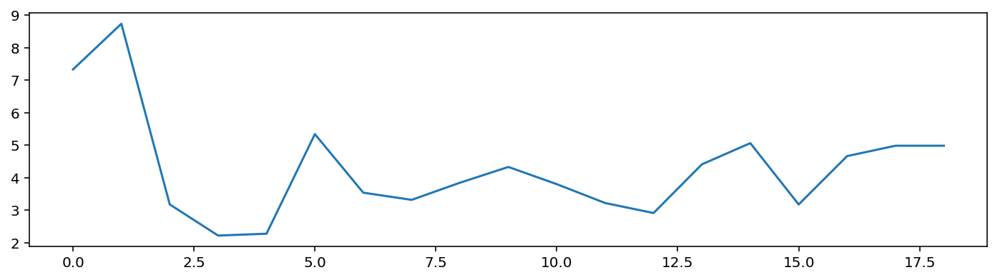

	 	 Test subset results
Test mean absolute percentage error per hour: 3.701319
Test mean absolute percentage error per day: 5.228861 
	 	 Validation Forecasting visualisation


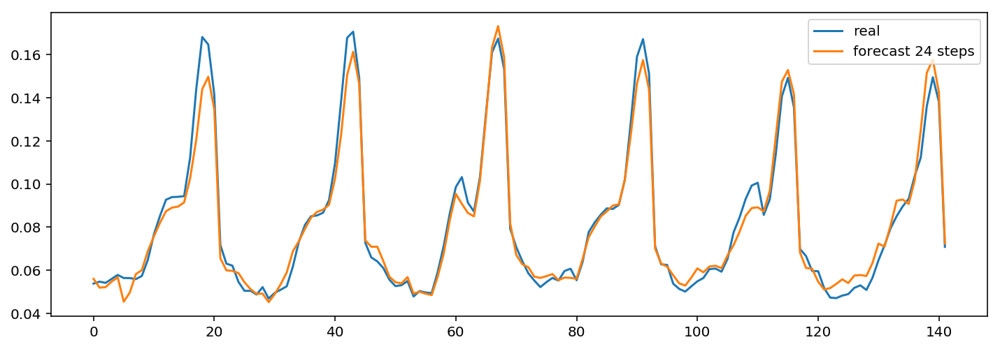

	 	 Forecasting a sample from Learning dataset


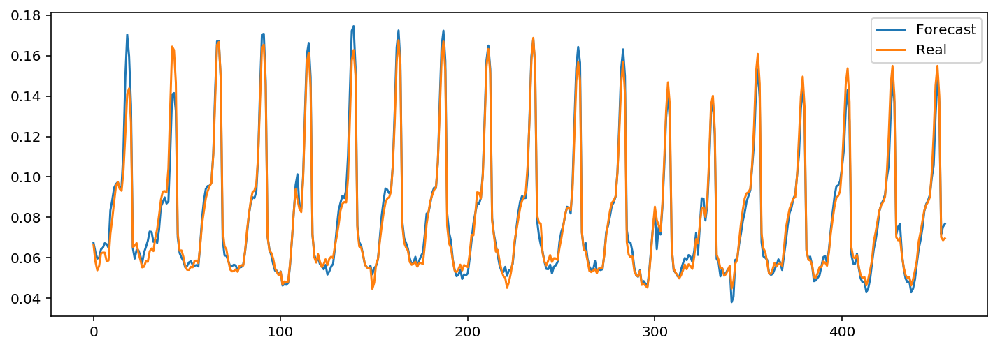

In [96]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 35
	 	 learning subset results
Hourly Learning mean absolute percentage error of 456 hours : 2.95262958031 
Daily Learning mean absolute percentage error of 19 days : 4.59978990806 
	 	 MAPError plot through Learning DataSet 


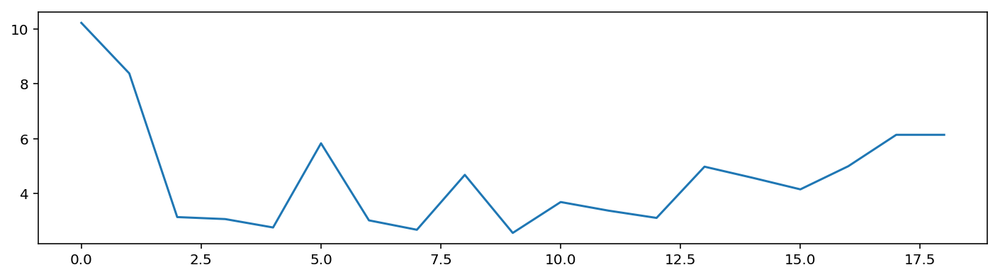

	 	 Test subset results
Test mean absolute percentage error per hour: 3.561262
Test mean absolute percentage error per day: 5.157931 
	 	 Validation Forecasting visualisation


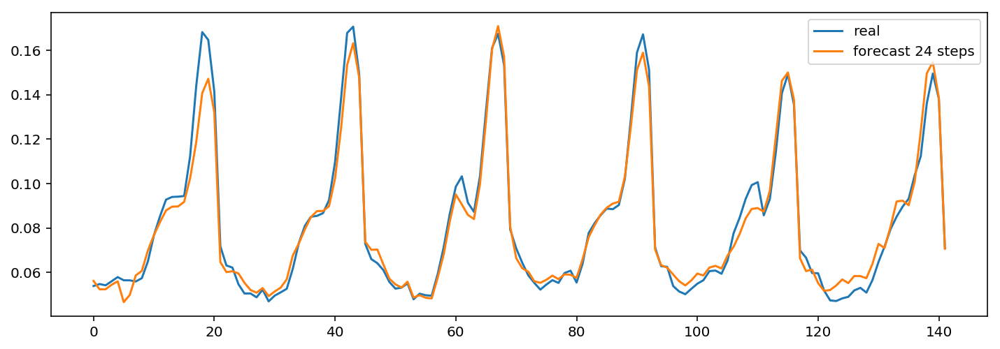

	 	 Forecasting a sample from Learning dataset


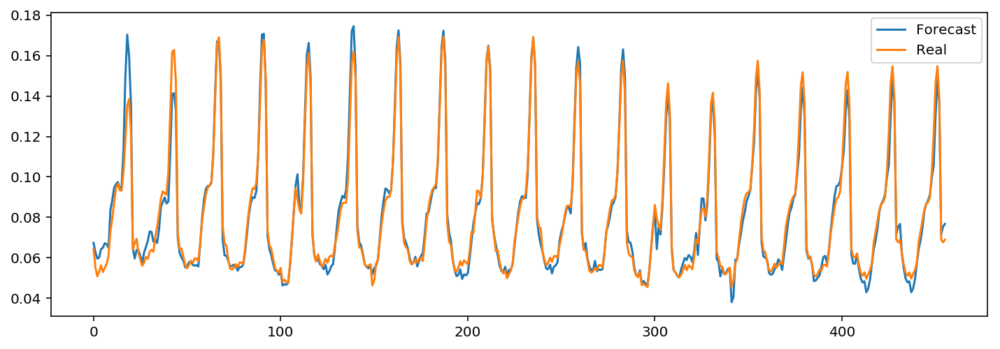

In [97]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 36
	 	 learning subset results
Hourly Learning mean absolute percentage error of 456 hours : 2.90676221812 
Daily Learning mean absolute percentage error of 19 days : 4.70201204952 
	 	 MAPError plot through Learning DataSet 


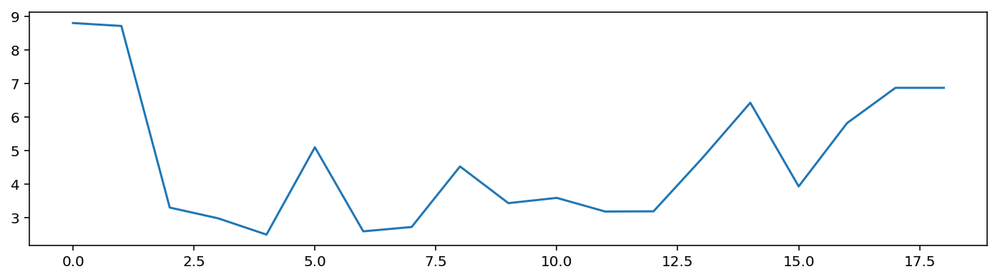

	 	 Test subset results
Test mean absolute percentage error per hour: 3.557123
Test mean absolute percentage error per day: 5.067411 
	 	 Validation Forecasting visualisation


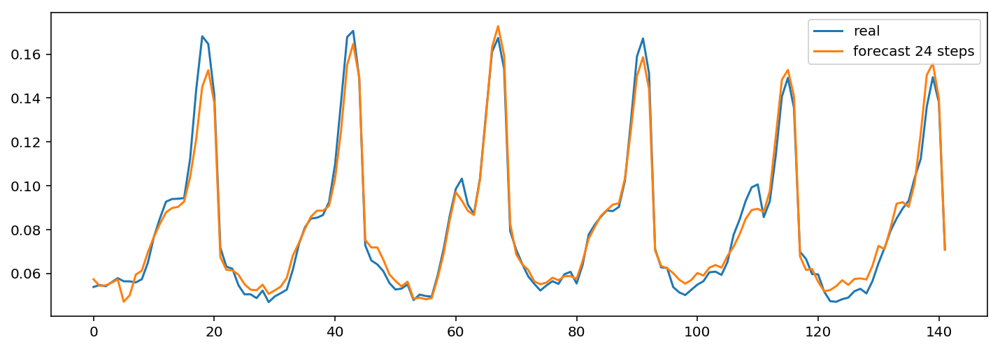

	 	 Forecasting a sample from Learning dataset


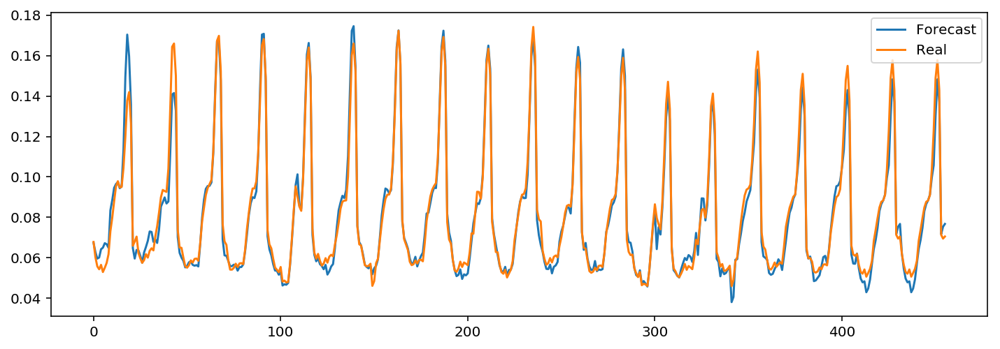

In [98]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 37
	 	 learning subset results
Hourly Learning mean absolute percentage error of 456 hours : 2.89901878067 
Daily Learning mean absolute percentage error of 19 days : 4.71868226403 
	 	 MAPError plot through Learning DataSet 


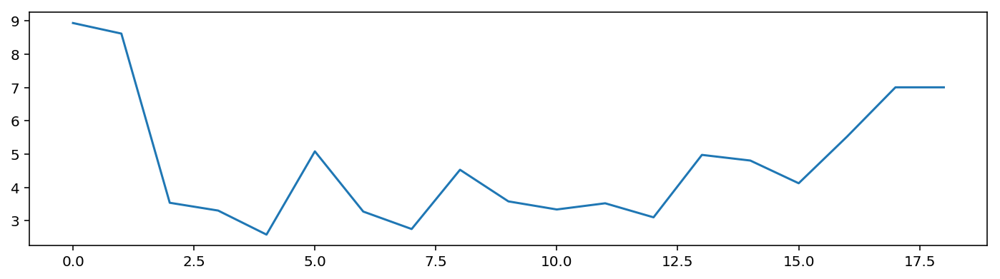

	 	 Test subset results
Test mean absolute percentage error per hour: 3.507721
Test mean absolute percentage error per day: 5.315433 
	 	 Validation Forecasting visualisation


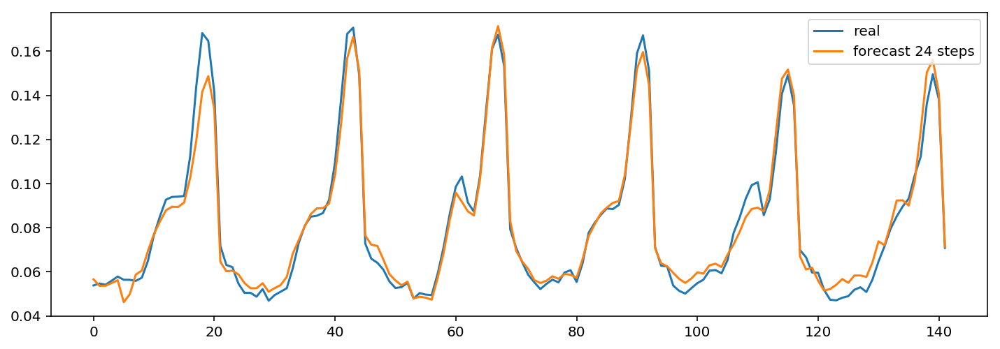

	 	 Forecasting a sample from Learning dataset


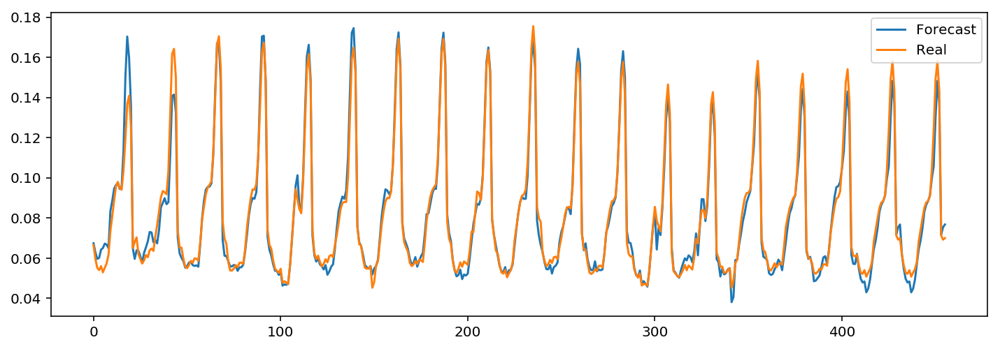

In [99]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [100]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2906.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.830145,6.610317
1,1.0,20.0,10.0,0.001,2913.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.271002,6.628031
2,2.0,20.0,10.0,0.001,2963.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.429525,6.573019
3,3.0,20.0,10.0,0.001,2911.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.385796,6.609058
4,4.0,20.0,10.0,0.001,2725.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.956918,6.926382
5,5.0,60.0,30.0,0.001,1269.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.159617,7.176886
6,6.0,50.0,10.0,0.001,1638.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.727545,7.626915
7,7.0,80.0,50.0,0.001,1044.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.688553,6.553393
8,8.0,90.0,30.0,0.002,1540.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,5.502599,7.012889
9,9.0,90.0,30.0,0.002,963.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.728009,6.913289


	 	 test num : 38
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 5.81091136819 
Daily Learning mean absolute percentage error of 23 days : 7.46378500565 
	 	 MAPError plot through Learning DataSet 


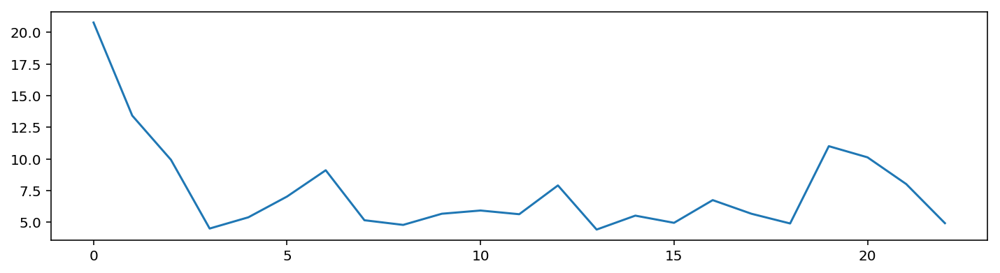

	 	 Test subset results
Test mean absolute percentage error per hour: 5.206542
Test mean absolute percentage error per day: 6.419156 
	 	 Validation Forecasting visualisation


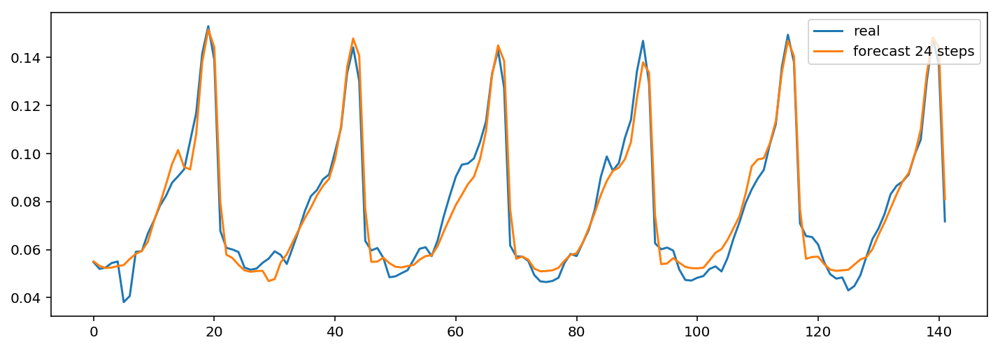

	 	 Forecasting a sample from Learning dataset


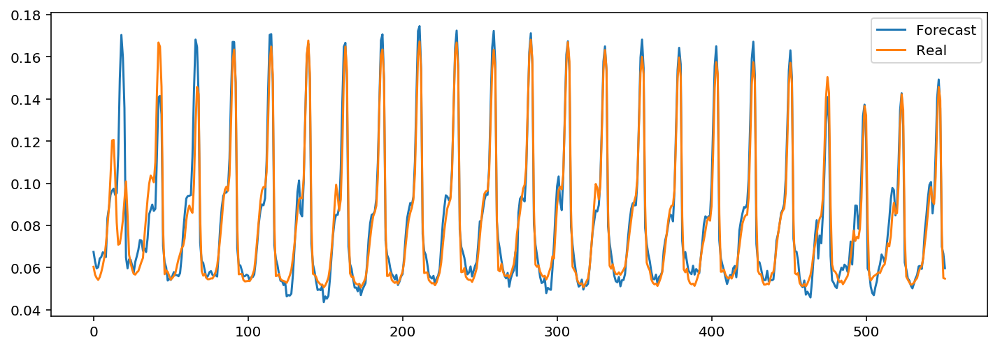

In [102]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 39
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 5.57333304817 
Daily Learning mean absolute percentage error of 23 days : 6.90541934967 
	 	 MAPError plot through Learning DataSet 


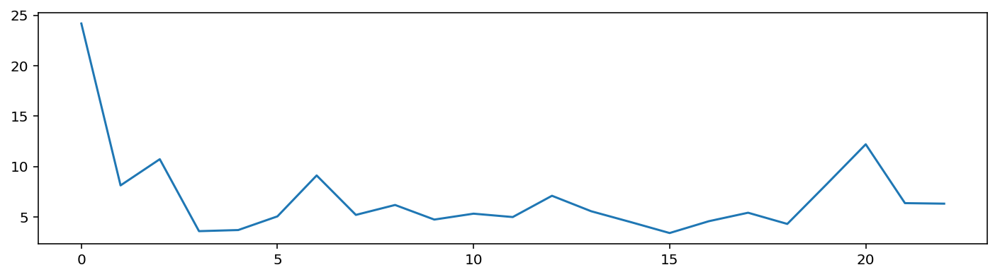

	 	 Test subset results
Test mean absolute percentage error per hour: 5.775132
Test mean absolute percentage error per day: 7.137229 
	 	 Validation Forecasting visualisation


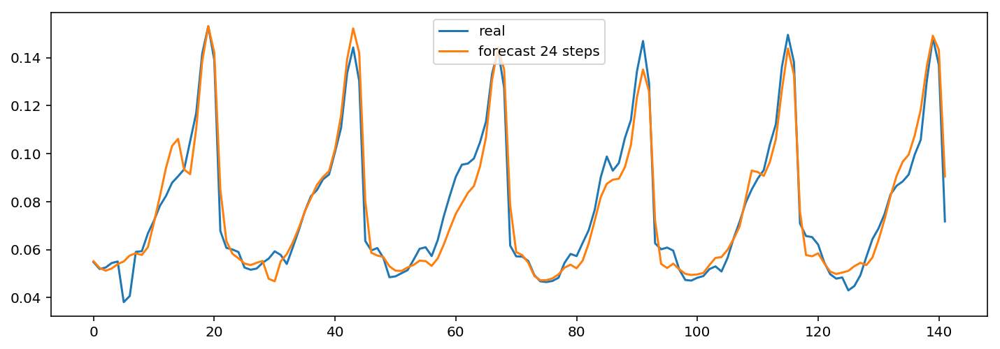

	 	 Forecasting a sample from Learning dataset


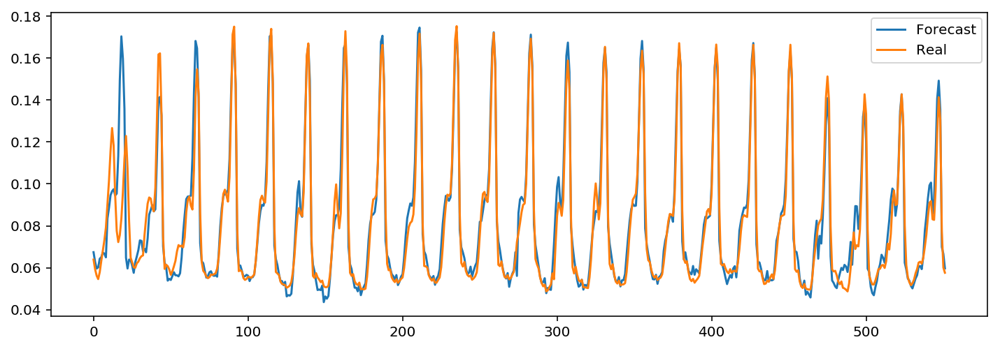

In [103]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 40
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 2.99766761 
Daily Learning mean absolute percentage error of 23 days : 6.23584224867 
	 	 MAPError plot through Learning DataSet 


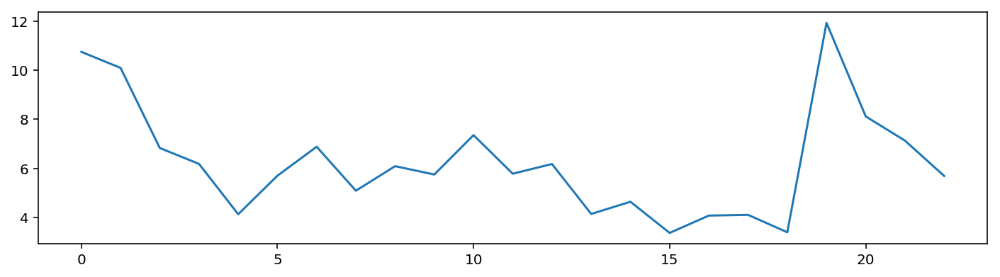

	 	 Test subset results
Test mean absolute percentage error per hour: 4.515387
Test mean absolute percentage error per day: 6.008857 
	 	 Validation Forecasting visualisation


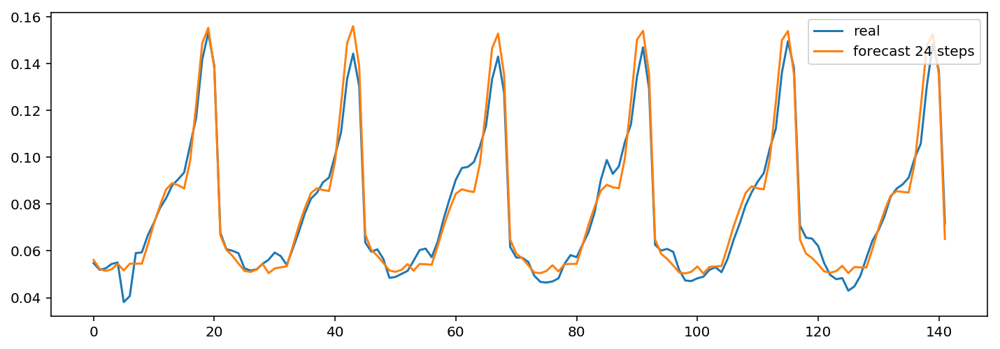

	 	 Forecasting a sample from Learning dataset


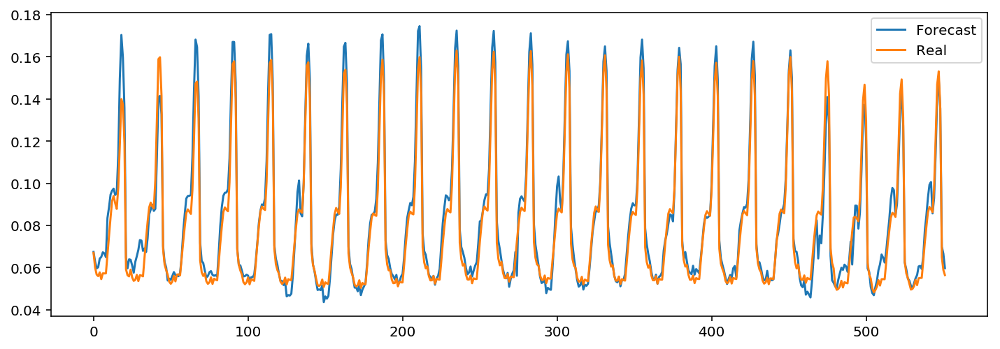

In [104]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 41
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 7.65656534412 
Daily Learning mean absolute percentage error of 23 days : 9.81583006486 
	 	 MAPError plot through Learning DataSet 


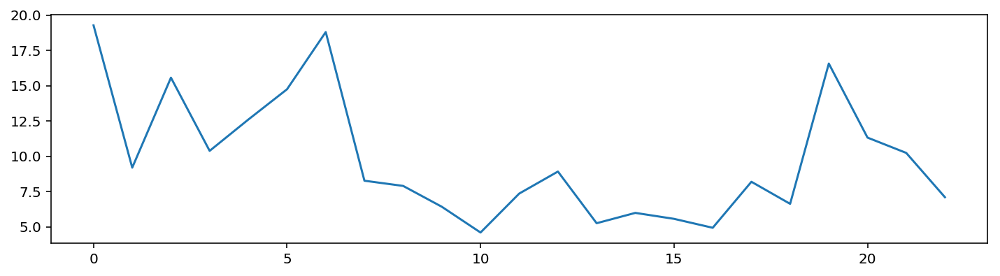

	 	 Test subset results
Test mean absolute percentage error per hour: 7.764843
Test mean absolute percentage error per day: 9.370885 
	 	 Validation Forecasting visualisation


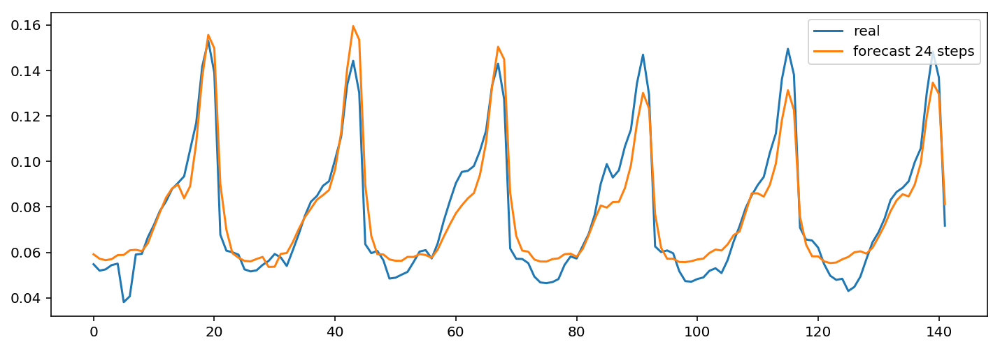

	 	 Forecasting a sample from Learning dataset


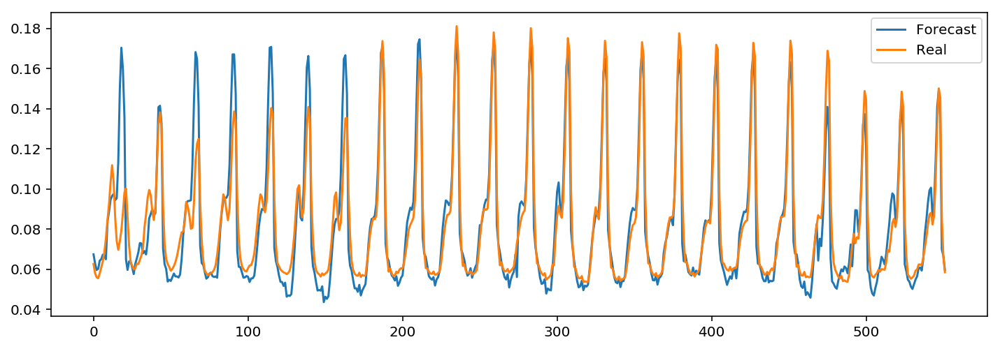

In [105]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 42
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 5.48259524273 
Daily Learning mean absolute percentage error of 23 days : 6.81383173362 
	 	 MAPError plot through Learning DataSet 


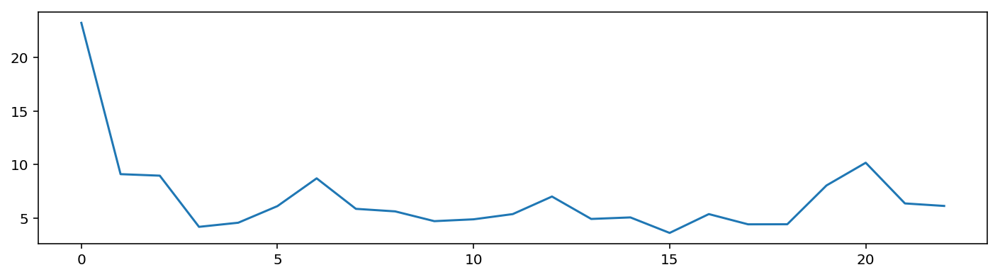

	 	 Test subset results
Test mean absolute percentage error per hour: 5.928862
Test mean absolute percentage error per day: 7.158235 
	 	 Validation Forecasting visualisation


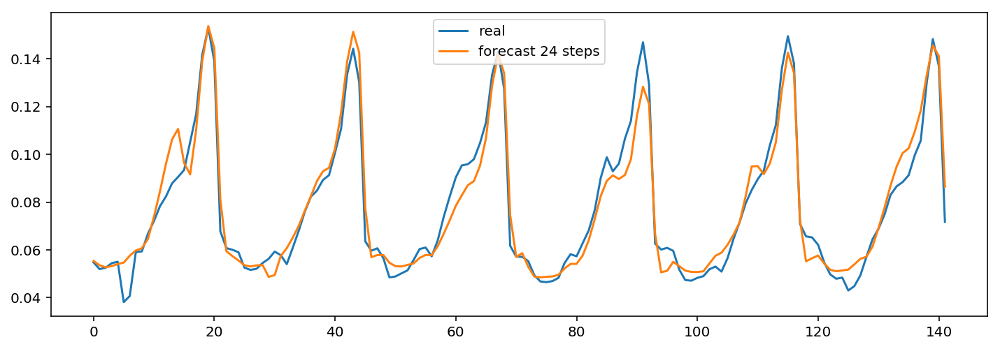

	 	 Forecasting a sample from Learning dataset


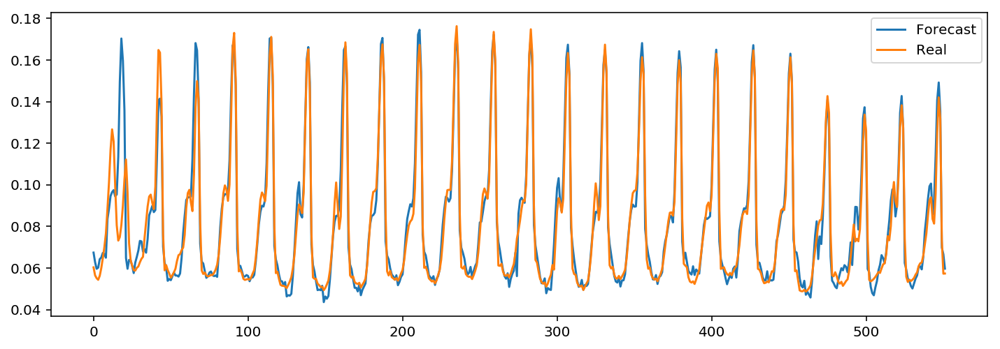

In [106]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 43
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 2.97858166907 
Daily Learning mean absolute percentage error of 23 days : 5.84376829603 
	 	 MAPError plot through Learning DataSet 


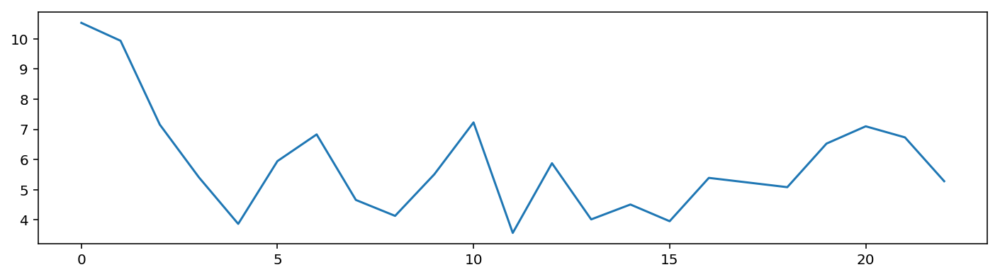

	 	 Test subset results
Test mean absolute percentage error per hour: 4.485507
Test mean absolute percentage error per day: 6.114966 
	 	 Validation Forecasting visualisation


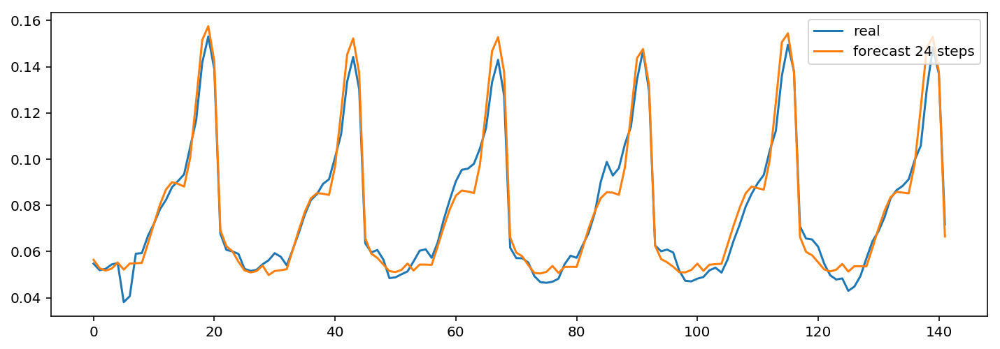

	 	 Forecasting a sample from Learning dataset


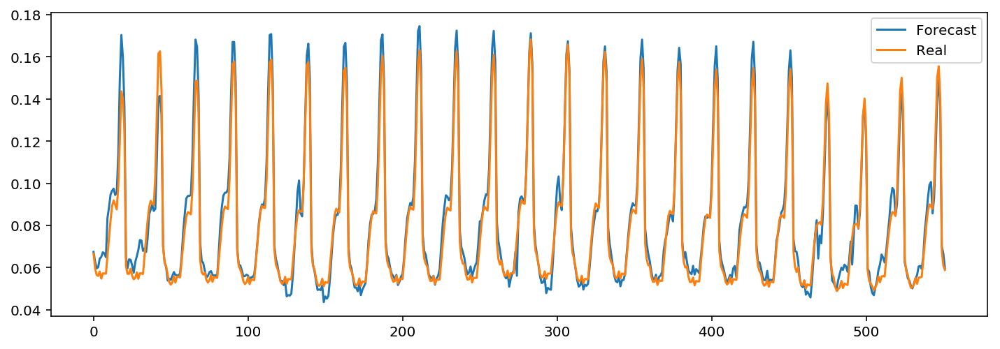

In [107]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 44
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 2.50932013654 
Daily Learning mean absolute percentage error of 23 days : 4.15461593089 
	 	 MAPError plot through Learning DataSet 


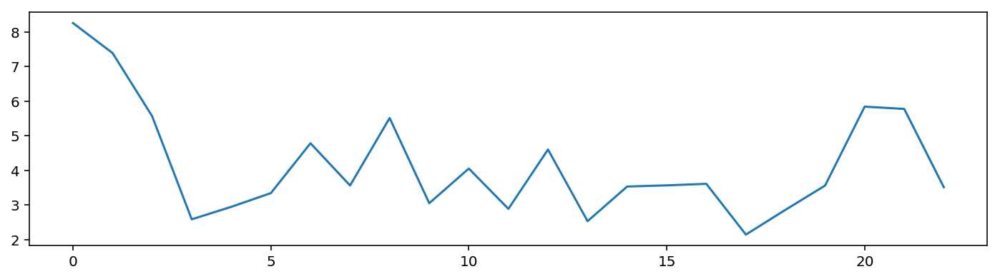

	 	 Test subset results
Test mean absolute percentage error per hour: 5.150018
Test mean absolute percentage error per day: 7.209618 
	 	 Validation Forecasting visualisation


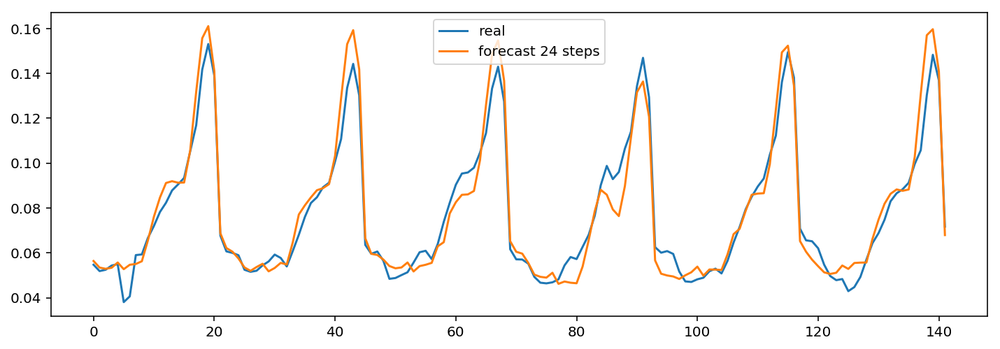

	 	 Forecasting a sample from Learning dataset


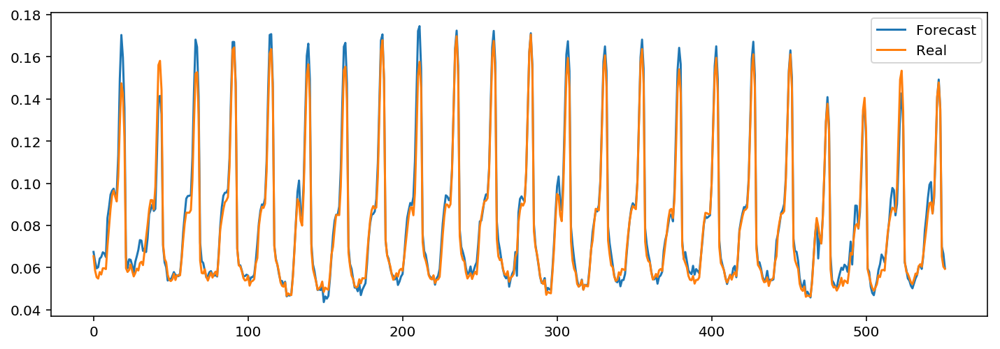

In [108]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 45
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 2.86183748573 
Daily Learning mean absolute percentage error of 23 days : 4.24393523258 
	 	 MAPError plot through Learning DataSet 


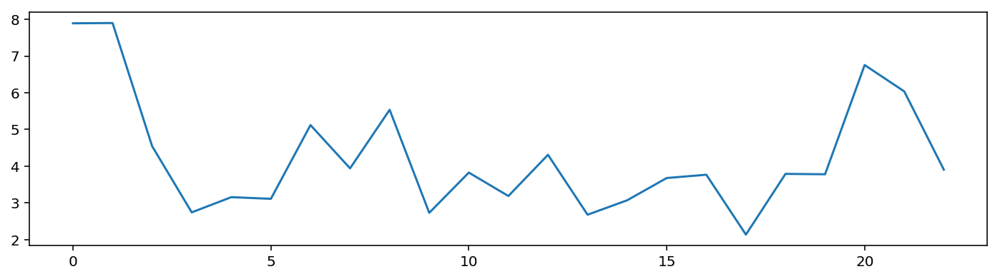

	 	 Test subset results
Test mean absolute percentage error per hour: 5.714064
Test mean absolute percentage error per day: 7.804478 
	 	 Validation Forecasting visualisation


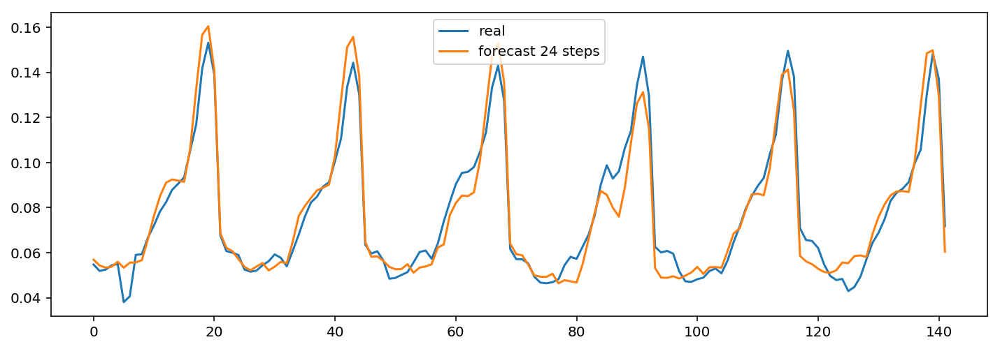

	 	 Forecasting a sample from Learning dataset


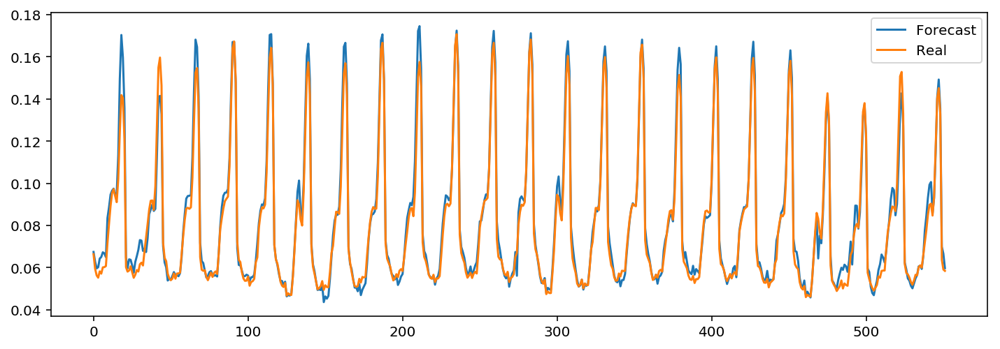

In [109]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [110]:
UsedInputs = np.array(UsedInputList[38:])

FinalError = np.array(MAPErrorList[38:])

summary = pd.DataFrame(np.concatenate((Models_IDs[38:],Models_parameters[38:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,38.0,20.0,10.0,0.002,2992.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,7.463785,6.419156
1,39.0,20.0,10.0,0.002,2990.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,6.905419,7.137229
2,40.0,20.0,10.0,0.002,2791.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,6.235842,6.008857
3,41.0,20.0,10.0,0.002,327.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,9.815830,9.370885
4,42.0,20.0,10.0,0.002,2816.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,6.813832,7.158235
5,43.0,20.0,10.0,0.002,2985.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.843768,6.114966
6,44.0,20.0,10.0,0.002,2983.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,4.154616,7.209618
7,45.0,20.0,10.0,0.002,1790.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.243935,7.804478


In [112]:
xmodel = ModelsList[34]
xmodel.optimizer.lr.get_value()

array(0.0010000000474974513, dtype=float32)

	 	 test num : 46
	 	 learning subset results
Hourly Learning mean absolute percentage error of 576 hours : 2.76126683754 
Daily Learning mean absolute percentage error of 24 days : 4.74177822471 
	 	 MAPError plot through Learning DataSet 


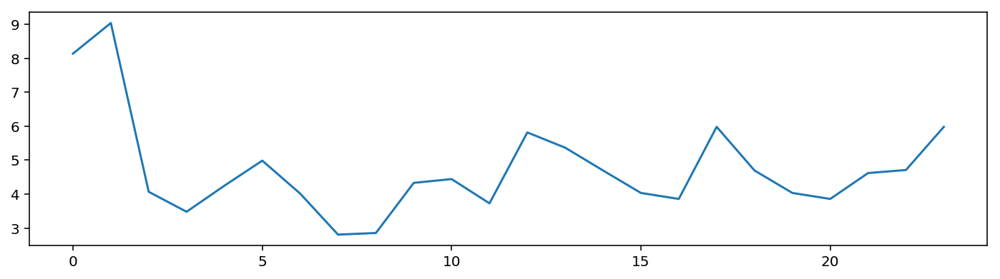

	 	 Test subset results
Test mean absolute percentage error per hour: 3.517504
Test mean absolute percentage error per day: 5.028583 
	 	 Validation Forecasting visualisation


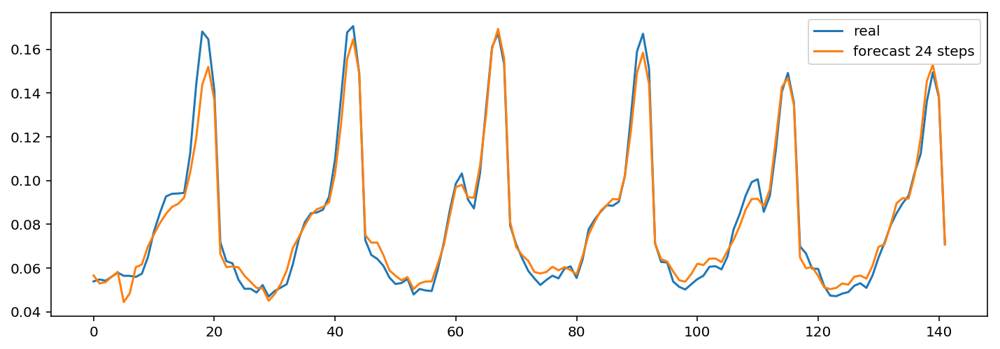

	 	 Forecasting a sample from Learning dataset


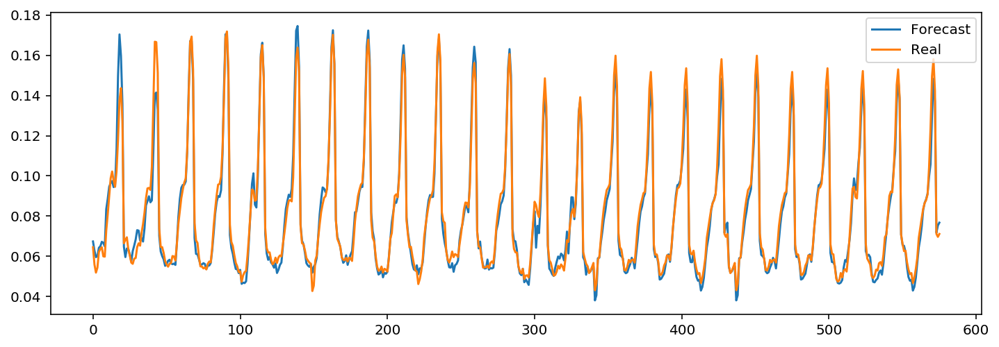

In [114]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/ramadan/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 47
	 	 learning subset results
Hourly Learning mean absolute percentage error of 576 hours : 2.68918082571 
Daily Learning mean absolute percentage error of 24 days : 4.45356333256 
	 	 MAPError plot through Learning DataSet 


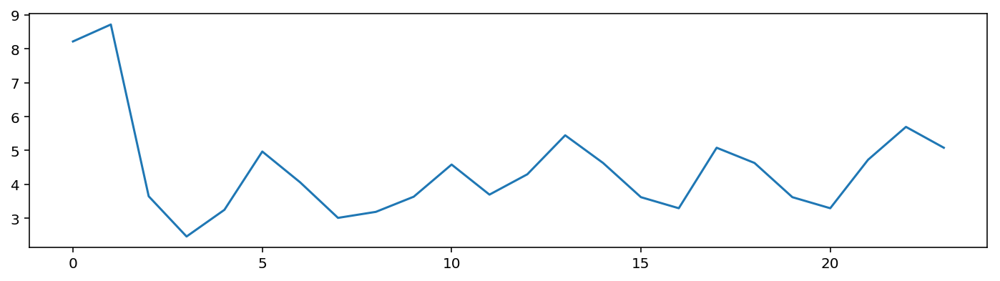

	 	 Test subset results
Test mean absolute percentage error per hour: 3.453556
Test mean absolute percentage error per day: 5.034647 
	 	 Validation Forecasting visualisation


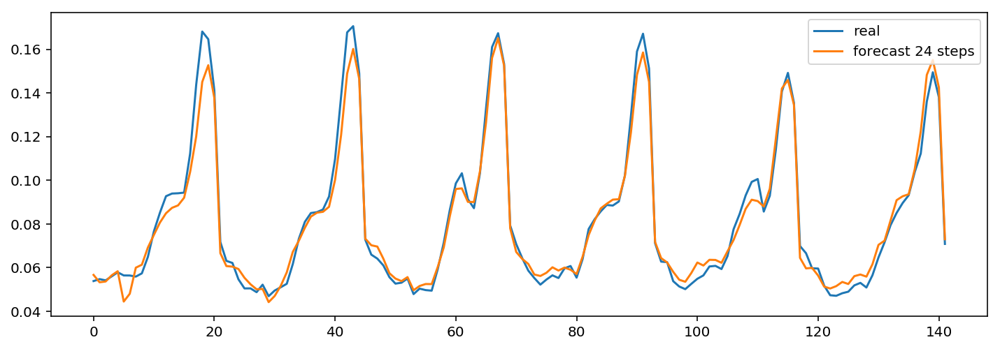

	 	 Forecasting a sample from Learning dataset


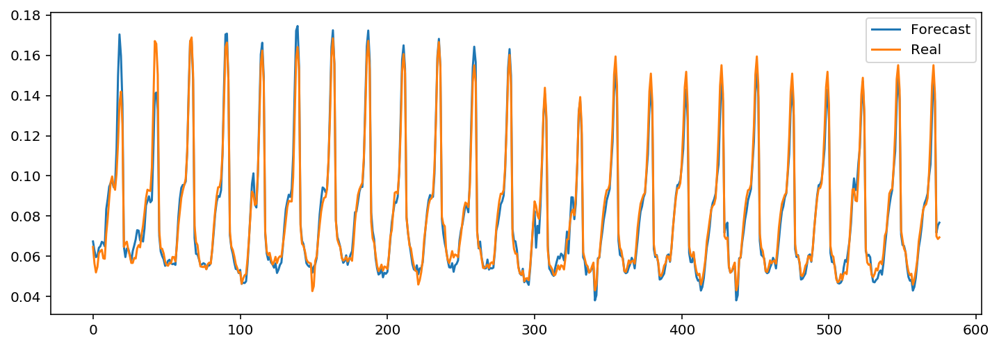

In [115]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/ramadan/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 48
	 	 learning subset results
Hourly Learning mean absolute percentage error of 576 hours : 2.80876694988 
Daily Learning mean absolute percentage error of 24 days : 4.94042425354 
	 	 MAPError plot through Learning DataSet 


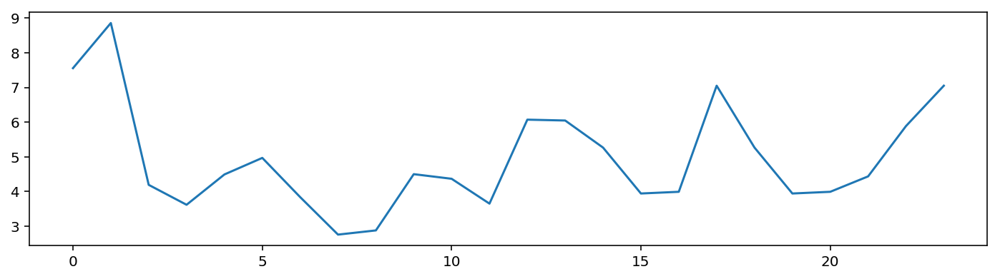

	 	 Test subset results
Test mean absolute percentage error per hour: 3.565290
Test mean absolute percentage error per day: 5.152572 
	 	 Validation Forecasting visualisation


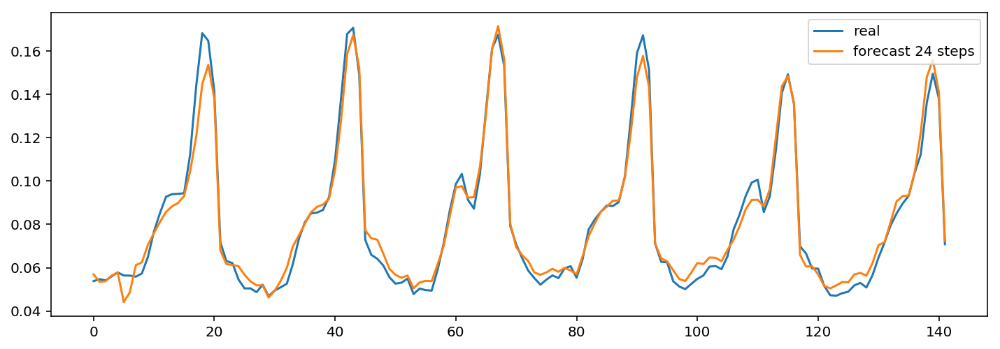

	 	 Forecasting a sample from Learning dataset


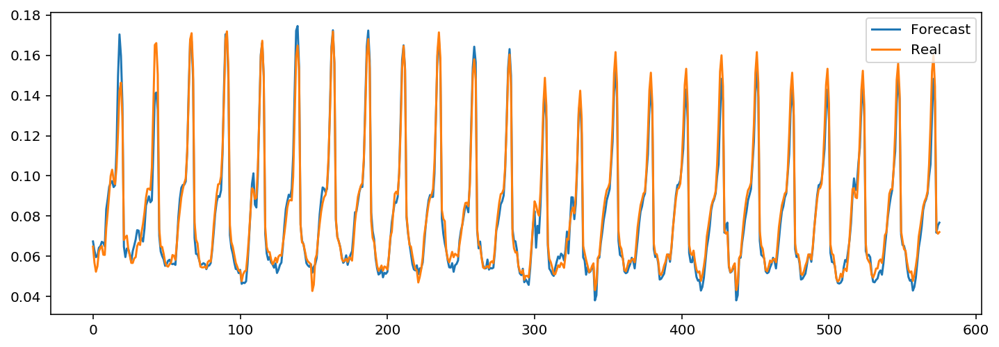

In [116]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/ramadan/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [22]:
def getForecastingResults2(learninginputs,learningoutputs,testinputs,testoutputs,Model, nbrInputs, IsShift,previoushour,season,timeSteps):
    
    testPeriod= 144
    
    predictionPeriod = learninginputs.index.size-testPeriod
    temp=learninginputs.iloc[:predictionPeriod-24].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod-24]

    
    
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    testPeriod= 144

    forecasting_history=pd.DataFrame(np.random.randn(dendi, 3),columns=['real', 'forecast 24 steps','forecast 1 step'],index=pd.date_range(dstart,freq='H',periods=142))
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
        forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]


    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)

    
    return forecasting_history

In [23]:
def getForecastingResults4( learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

    Model = Model
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningRMSE= rmse(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningRMSE= rmse(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning root mean square error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningRMSE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning root mean square error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningRMSE))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestRMSE= rmse(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testRMSE= rmse(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)
    
    print('Test mean absolute error per hour: %f' %HtestRMSE)
    print('Test mean absolute error per day: %f ' %testRMSE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

-------Input preparation process complet-------
	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 3.32096719059 
Daily Learning mean absolute percentage error of 23 days : 5.02037560882 
Hourly Learning mean absolute error of 552 hours : 0.00250660166555 
Daily Learning mean absolute error of 23 days : 0.00401019450283 
Hourly Learning root mean square error of 552 hours : 0.003670075731241359 
Daily Learning root mean square error of 23 days : 0.005910655262971577 
	 	 MAPError plot through Learning DataSet 


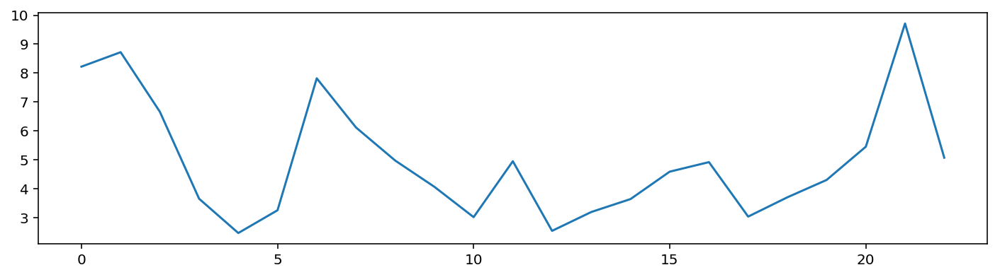

	 	 Test subset results
Test mean absolute percentage error per hour: 2.556675
Test mean absolute percentage error per day: 4.409836 
Test mean absolute error per hour: 0.001834
Test mean absolute error per day: 0.003545 
Test mean absolute error per hour: 0.002583
Test mean absolute error per day: 0.004545 
	 	 Validation Forecasting visualisation


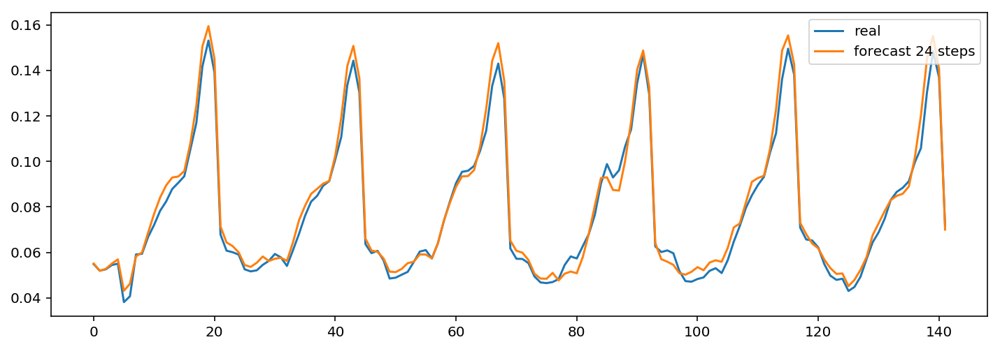

	 	 Test subset results
Test mean absolute percentage error per hour: 2.556675
Test mean absolute percentage error per day: 4.409836 


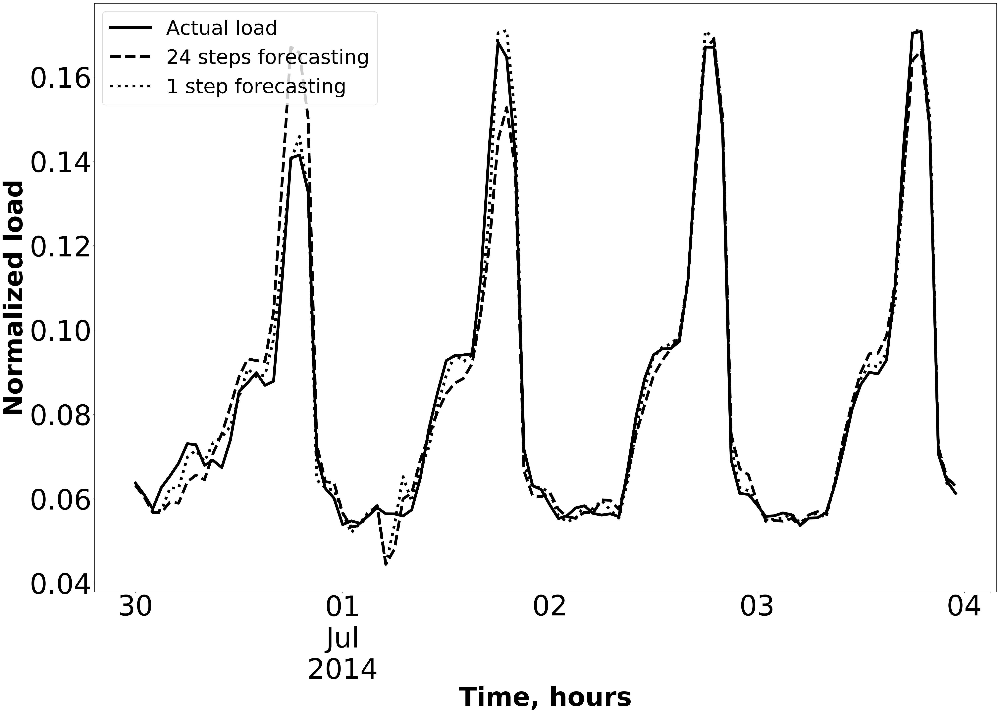

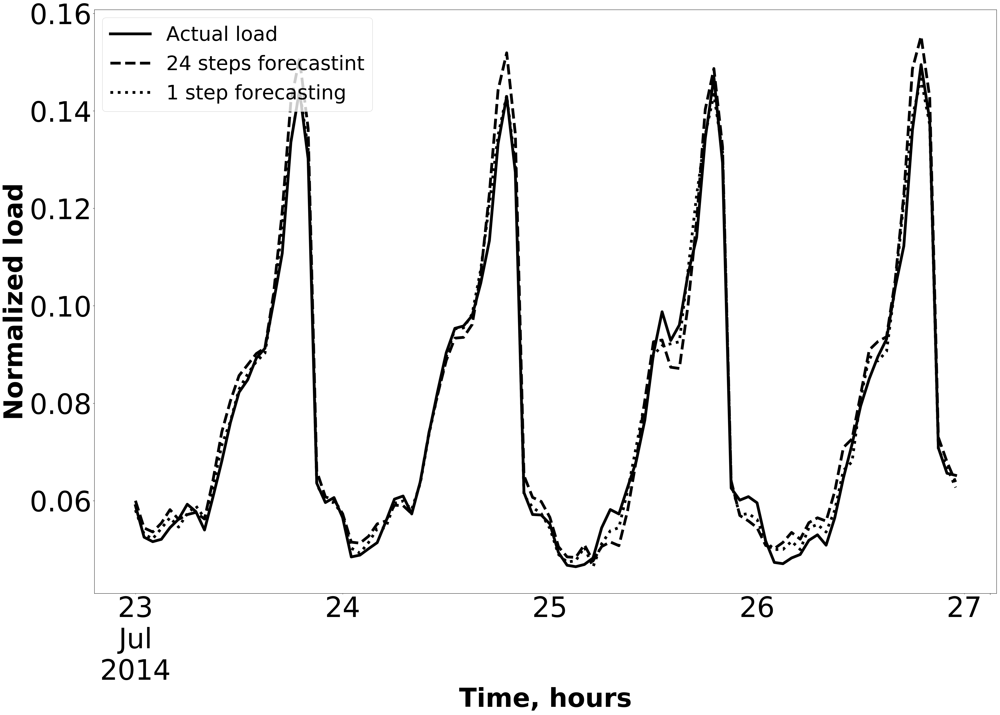

In [24]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)


LSTM_Model = load_model('Models/ramadan/lstm_47_2018-07-22')
# LSTM_Model= ModelsList[43]
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults4(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)


TestHourlyForecast = getForecastingResults2(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)

plt.rc('xtick', labelsize=70)    # fontsize of the tick labels
plt.rc('ytick', labelsize=70)

a1=1
b1=5

a2=1
b2=5

LearningDailyForecast.iloc[a1*24:b1*24,0].plot(label='Actual load',c='black',marker='.',linewidth=7,linestyle='-',figsize=(35,25))
LearningDailyForecast.iloc[a1*24:b1*24,1].plot(label='24 steps forecasting',c='black',linewidth=7,linestyle='--')
LearningDailyForecast.iloc[a1*24:b1*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')
plt.legend(fontsize=50, loc='best', borderaxespad=0.4)

plt.tight_layout()
plt.savefig('RamadanLearning.pdf')

plt.show()


TestHourlyForecast.iloc[a2*24:b2*24,0].plot(label='Actual load',c='black',marker='.',linestyle='-',linewidth=7,figsize=(35,25))
TestHourlyForecast.iloc[a2*24:b2*24,1].plot(label='24 steps forecastint',c='black',linewidth=7,linestyle='--')
TestHourlyForecast.iloc[a2*24:b2*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.legend( fontsize= 50,loc='best', borderaxespad=0.4)
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')

plt.tight_layout()
plt.savefig('RamadanTest.pdf')

plt.show()


	 	 learning subset results
Hourly Learning mean absolute percentage error of 552 hours : 3.32096771859 
Daily Learning mean absolute percentage error of 23 days : 5.02037542728 
Hourly Learning mean absolute error of 552 hours : 0.00250660186127 
Daily Learning mean absolute error of 23 days : 0.0040101943746 
	 	 MAPError plot through Learning DataSet 


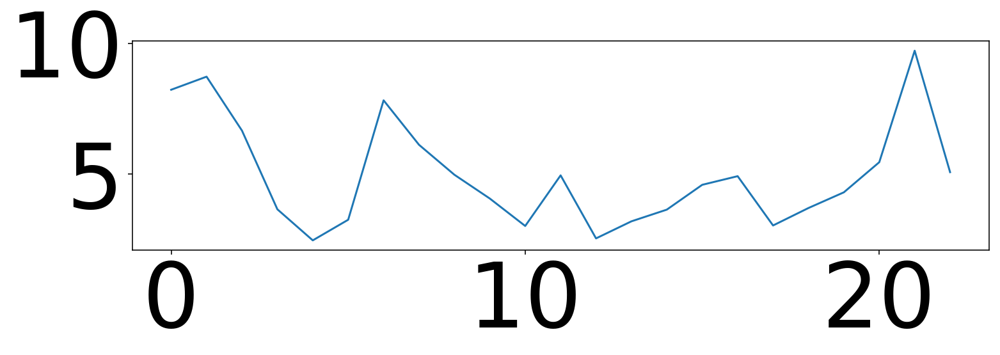

	 	 Test subset results
Test mean absolute percentage error per hour: 2.556672
Test mean absolute percentage error per day: 4.409832 
Test mean absolute error per hour: 0.001834
Test mean absolute error per day: 0.003545 
	 	 Validation Forecasting visualisation


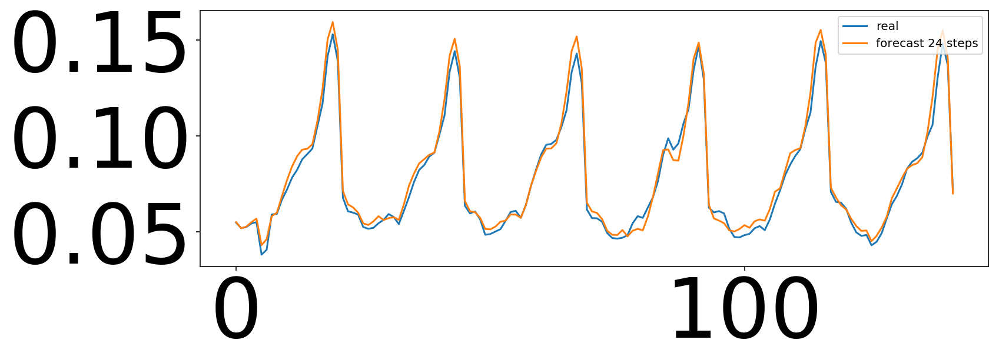

	 	 Forecasting a sample from Learning dataset


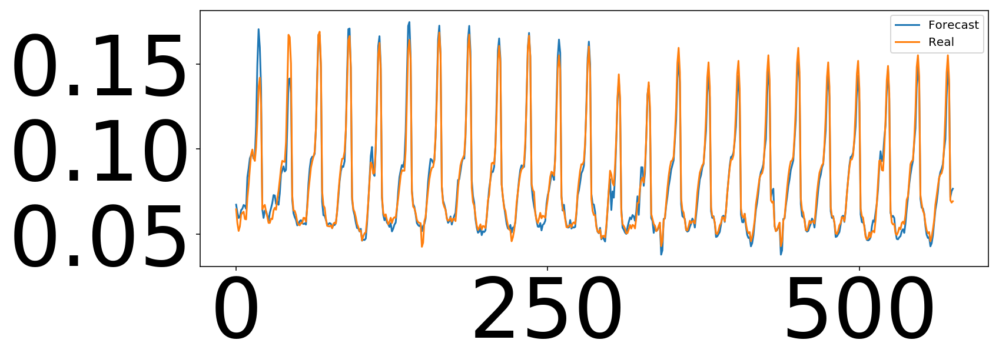

In [130]:
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[47].index= range(ForecastingList[47].index.size)
plt.plot(ForecastingList[47].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[47].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()